# A Fast.ai protein classifier using images

##### version 2.0

#### Paper: [TBD](https://localhost)

#### Dataset: [SHREC 2025: Protein Shape Classification](https://shrec2025.drugdesign.fr/)

#### Other software: [TBD](https://localhost)

Description: this notebook uses 591616 images (32 Gb) captured with `scripts/pyvista-screenshot.py` to train a CNN (e.g. ResNet) to classify proteins.

<!--
http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0016-21-7vuy_2:B:A_model1-0-0.jpg
http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0018-15-8rae_1:A:A_model1-0-0.jpg
http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0025-35-6nr9_8:H:H_model1-0-0.jpg
http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0029-38-4yxw_3:G:G_model1-0-0.jpg
http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0032-12-6fyy_21:U:R_model1-0-0.jpg
http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0043-92-7w3a_19:S:s_model1-0-0.jpg
http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0044-18-8pw6_63:WB:l1_model1-0-0.jpg
http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0047-56-5cpk_4:D:D_model1-0-0.jpg
http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0053-81-6qc4_34:RA:B8_model1-0-0.jpg
http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0054-51-5xrt_2:D:D_model1-0-0.jpg
http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0055-84-7nj5_3:C:C_model1-0-0.jpg
http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0056-37-4u3n_53:AB:M7_model1-0-0.jpg
http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0257-09-7taz_1:A:A_model1-0-0.jpg
-->

<table>
    <tr>
        <td><center>21</center></td>
        <td><center>15</center></td>
        <td><center>35</center></td>
    </tr>
    <tr>
        <td>
            <img width="100%" height="100%" src="http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0016-21-7vuy_2:B:A_model1-0-0.jpg"></img>
        </td>
        <td>
            <img width="100%" height="100%" src="http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0018-15-8rae_1:A:A_model1-0-0.jpg"></img>
        </td>
        <td>
            <img width="100%" height="100%" src="http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0025-35-6nr9_8:H:H_model1-0-0.jpg"></img>
        </td>
    </tr>
    <tr>
        <td><center>38</center></td>
        <td><center>12</center></td>
        <td><center>92</center></td>
    </tr>
    <tr>
        <td>
            <img width="100%" height="100%" src="http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0029-38-4yxw_3:G:G_model1-0-0.jpg"></img>
        </td>
        <td>
            <img width="100%" height="100%" src="http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0032-12-6fyy_21:U:R_model1-0-0.jpg"></img>
        </td>
        <td>
            <img width="100%" height="100%" src="http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0043-92-7w3a_19:S:s_model1-0-0.jpg"></img>
        </td>
    </tr>
    <tr>
        <td><center>56</center></td>
        <td><center>81</center></td>
        <td><center>51</center></td>
    </tr>
    <tr>
        <td>
            <img width="100%" height="100%" src="http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0047-56-5cpk_4:D:D_model1-0-0.jpg"></img>
        </td>
        <td>
            <img width="100%" height="100%" src="http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0053-81-6qc4_34:RA:B8_model1-0-0.jpg"></img>
        </td>
        <td>
            <img width="100%" height="100%" src="http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0054-51-5xrt_2:D:D_model1-0-0.jpg"></img>
        </td>
    </tr>
    <tr>
        <td><center>84</center></td>
        <td><center>37</center></td>
        <td><center>09</center></td>
    </tr>
    <tr>
        <td>
            <img width="100%" height="100%" src="http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0055-84-7nj5_3:C:C_model1-0-0.jpg"></img>
        </td>
        <td>
            <img width="100%" height="100%" src="http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0056-37-4u3n_53:AB:M7_model1-0-0.jpg"></img>
        </td>
        <td>
            <img width="100%" height="100%" src="http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0257-09-7taz_1:A:A_model1-0-0.jpg"></img>
        </td>
    </tr>
</table>

In [1]:
env = dict()
env['use_dataparallel'] = False

import os
if env['use_dataparallel']:
    os.environ['CUDA_VISIBLE_DEVICES'] = '0,1'
    os.environ['OPENBLAS_NUM_THREADS'] = '1'
else:
    os.environ['CUDA_VISIBLE_DEVICES'] = '0'
    os.environ['OPENBLAS_NUM_THREADS'] = '1'

In [2]:
!nvidia-smi

Fri Apr  4 12:12:10 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.127.05             Driver Version: 550.127.05     CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA RTX A6000               Off |   00000000:01:00.0 Off |                    0 |
| 30%   46C    P8             39W /  300W |     215MiB /  46068MiB |      2%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

# Import-initialization


%matplotlib inline

or

%matplotlib notebook

In [3]:
!pwd

/mnt/raid1/repos/shrec2025/Protein_Classification/notebooks


In [4]:
!echo $HOME

/home/biagio


In [5]:
!ls

backups
shrec-2025-protein-classification-via-images.ipynb
shrec-2025-protein-classification-via-images-v2.0.ipynb
shrec_run-GPU-3.ipynb


In [6]:
!pip -V

pip 24.3.1 from /mnt/raid1/venvs/sam2/lib/python3.12/site-packages/pip (python 3.12)


In [7]:
!pip list | grep -i "fastai\|semtorch\|Pillow\|torch" # remember that Pillow >= 8.3.0 causes 'RuntimeError: Could not infer dtype of PILImage' while building the DataLoader

DEPRECATION: Loading egg at /mnt/raid1/venvs/sam2/lib/python3.12/site-packages/MultiScaleDeformableAttention-1.0-py3.12-linux-x86_64.egg is deprecated. pip 25.1 will enforce this behaviour change. A possible replacement is to use pip for package installation. Discussion can be found at https://github.com/pypa/pip/issues/12330
fastai                        2.7.19
pillow                        10.4.0
torch                         2.5.1
torchaudio                    2.5.1
torchsde                      0.2.6
torchvision                   0.20.1


In [10]:
def get_pkg_ver(pkg_name):
    import subprocess
    pkg_ver = subprocess.check_output(["/bin/bash", '-c', 'pip list | grep -iw "'+pkg_name+'" | awk "{print \\$2}"'])
    return str(pkg_ver.decode()).replace('\n','')

In [11]:
get_pkg_ver('torch')

DEPRECATION: Loading egg at /mnt/raid1/venvs/sam2/lib/python3.12/site-packages/MultiScaleDeformableAttention-1.0-py3.12-linux-x86_64.egg is deprecated. pip 25.1 will enforce this behaviour change. A possible replacement is to use pip for package installation. Discussion can be found at https://github.com/pypa/pip/issues/12330


'2.5.1'

In [12]:
env['problem'] = 'classification'
#env['problem'] = 'segmentation'
#env['problem'] = 'regression'

if env['problem'] == 'segmentation':
    !pip install semtorch

!pip install --upgrade albumentations

'''
if get_pkg_ver('fastai') != '2.7.10':
    !pip install fastai==2.7.10
if get_pkg_ver('Pillow') != '8.2.0':
    !pip install Pillow==8.2.0         # downgrade
if get_pkg_ver('torch') != '1.13.0':
    !pip install torch==1.13.0
'''
        
!pip show fastai

from fastai.basics import *
from fastai.vision import models
from fastai.vision.all import *
from fastai.metrics import *
from fastai.data.all import *
from fastai.callback import *

if env['problem'] == 'segmentation':
    # SemTorch
    import semtorch
    from semtorch import get_segmentation_learner

from pathlib import Path
import random
import numpy as np

# Display larger jupyter cells!
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))

if env['use_dataparallel']:
    from fastai.distributed import *
    cuda_training_device = 0           # otherwise: RuntimeError: module must have its parameters and buffers on device cuda:0 (device_ids[0]) but found one of them on device: cuda:1
else:
    pass
    #cuda_training_device = 1           # the device of your choice
    
print(f'{torch.cuda.is_available() = }')

DEPRECATION: Loading egg at /mnt/raid1/venvs/sam2/lib/python3.12/site-packages/MultiScaleDeformableAttention-1.0-py3.12-linux-x86_64.egg is deprecated. pip 25.1 will enforce this behaviour change. A possible replacement is to use pip for package installation. Discussion can be found at https://github.com/pypa/pip/issues/12330
  Attempting uninstall: albucore
    Found existing installation: albucore 0.0.21
    Uninstalling albucore-0.0.21:
      Successfully uninstalled albucore-0.0.21
  Attempting uninstall: albumentations
    Found existing installation: albumentations 1.4.22
    Uninstalling albumentations-1.4.22:
      Successfully uninstalled albumentations-1.4.22

[notice] A new release of pip is available: 24.3.1 -> 25.0.1
[notice] To update, run: pip install --upgrade pip
DEPRECATION: Loading egg at /mnt/raid1/venvs/sam2/lib/python3.12/site-packages/MultiScaleDeformableAttention-1.0-py3.12-linux-x86_64.egg is deprecated. pip 25.1 will enforce this behaviour change. A possible r

/tmp/ipykernel_2188990/3621787404.py:38: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython.display
  from IPython.core.display import display, HTML


torch.cuda.is_available() = True


In [13]:
import torch
torch.zeros(1).cuda()

tensor([0.], device='cuda:0')

# Determinism


In [14]:
from datetime import datetime

env['seed'] = 2025
env['launch_time'] = datetime.now().strftime('%Y-%m-%d_%H.%M.%S')

random.seed(env['seed'])
set_seed(env['seed'])
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

# Secondary Functions


Get filenames both for images and masks

In [15]:
#export
def get_y_fn(img_fn):
    if 'mask' in str(img_fn):
        print(f'Warning! {img_fn} looks like a mask!')
    return Path(str(img_fn).replace("images", "masks").replace('.jpg', '.png'))

#export
def get_x_fns(path, folders, debug=False):
    new_fns = []
    for dset_dir in folders:
        fns = get_image_files(path / dset_dir)
        for fn in fns:
            if not 'mask' in str(fn):
                new_fns.append(fn)
    if debug:
        fn_name = inspect.currentframe().f_code.co_name
        print(f'{fn_name} - {len(new_fns)} - {new_fns}')
    return new_fns

In [52]:
# Given the filename of an image, produce its categorical label (shape or spline)
#export
def img2lbl(img_fn, debug=False):
    pathfn = Path(img_fn)
    return pathfn.parent.name

classification_getter = [
                            lambda o: o,
                            lambda o: img2lbl(o),
                        ]

'''
# Given the filename of an image, produce its control points (CPs) or angle (in case of shapes)
# In both cases, assemble everything into a (e.g. 1*2+20) vector (e.g (angle,0)+20 x,y coordinates for 10 CPs)
# and return it. Angle can't stay alone because the DataLoader wants a point, so two numbers :(
# --- Also remember this function produces data that is used only to _shape_ the DataLoader ---
# --- in show_batch_classification_regression(). Then in the body of the function, the      ---
# --- batch is transformed and reshaped in totally different ways, so you'll have to        ---
# --- double check everything in two places if you change anything in geom/spline params    ---
def img2kpts(img_fn, debug=False):
    pathfn = Path(img_fn)
    params = pathfn.parent / 'CPs.csv'                             # splines have Control Points (up to 10 CPs == 20 floats)
    if params.is_file():
        if env['max_spline_params'] != 0:
            csv_data = np.genfromtxt(params, delimiter=',')
            if debug:
                print(f'BEFORE PAD: {csv_data.shape = }')
            csv_data = csv_data.flatten()
            if csv_data.shape[0] != env['max_spline_params']:
                csv_data = np.pad(csv_data, (0, env['max_spline_params']-csv_data.shape[0]), 'constant')
                if debug:
                    print(f'AFTER  PAD: {csv_data.shape = }')
            spline_data = torch.from_numpy(csv_data).to(dtype=torch.float64)
            spline_data = spline_data.reshape(int(env['max_spline_params']/2), -1)
        else:
            spline_data = np.empty(None)
        if env['max_geom_params'] != 0:
            geom_data   = torch.from_numpy(np.array([0]*env['max_geom_params'])).to(dtype=torch.float64) #.reshape(int(env['max_geom_params']/2), -1))
        else:
            geom_data   = np.empty(None)
    else:
        if env['max_geom_params'] != 0:
            params = pathfn.parent / 'parameters.csv'                  # while shapes have Parameters (angle, x,y, a,b, n_petals)
            if not params.is_file():
                print(f'Error. Ground truth CSV file (CPs.csv or parameters.csv) is missing, please double check your dataset. Here is the content of the offending directory: {str(pathfn.parent)}')
                pathfn.parent.ls()
            csv_data    = np.genfromtxt(params, delimiter=',', skip_header=1)
            geom_data   = torch.from_numpy(csv_data).to(dtype=torch.float64)
            if debug:
                print(f'Returning just angle ({csv_data[0]}) in csv_data: {csv_data.shape = }')
        else:
            geom_data   = np.empty(None)
        if env['max_spline_params'] != 0:
            spline_data = torch.from_numpy(np.array([0]*env['max_spline_params'])).to(dtype=torch.float64)
            spline_data = spline_data.reshape(int(env['max_spline_params']/2), -1)
        else:
            spline_data = np.empty(None)
    if debug:
        print(f'\n {geom_data = } \n\n\n {spline_data = }')
    return geom_data, spline_data
'''

"\n# Given the filename of an image, produce its control points (CPs) or angle (in case of shapes)\n# In both cases, assemble everything into a (e.g. 1*2+20) vector (e.g (angle,0)+20 x,y coordinates for 10 CPs)\n# and return it. Angle can't stay alone because the DataLoader wants a point, so two numbers :(\n# --- Also remember this function produces data that is used only to _shape_ the DataLoader ---\n# --- in show_batch_classification_regression(). Then in the body of the function, the      ---\n# --- batch is transformed and reshaped in totally different ways, so you'll have to        ---\n# --- double check everything in two places if you change anything in geom/spline params    ---\ndef img2kpts(img_fn, debug=False):\n    pathfn = Path(img_fn)\n    params = pathfn.parent / 'CPs.csv'                             # splines have Control Points (up to 10 CPs == 20 floats)\n    if params.is_file():\n        if env['max_spline_params'] != 0:\n            csv_data = np.genfromtxt(params, 

In [18]:
'''
env['max_spline_params'] = 0
env['max_geom_params']   = 1
env['geom_params_dict']  = {
                             'angle'  : 0,
                             'x'      : 1,
                             'y'      : 2,
                             'a'      : 3,
                             'b'      : 4,
                             'npetals': 5,
                           }
'''

"\nenv['max_spline_params'] = 0\nenv['max_geom_params']   = 1\nenv['geom_params_dict']  = {\n                             'angle'  : 0,\n                             'x'      : 1,\n                             'y'      : 2,\n                             'a'      : 3,\n                             'b'      : 4,\n                             'npetals': 5,\n                           }\n"

In [19]:
#export

'''
classification_getter = [
                            lambda o: o,
                            lambda o: img2lbl(o),
                        ]
'''

'''
def get_y_classification_multioutput_regression(imgfn, debug=False):
    kpt = None
    lbl = img2lbl (imgfn, debug=debug)
    if env['problem'] == 'classification':        # use the classification-regression structure, but only for classification (just for testing)
        if debug:
            print('get_y(): ', lbl)
        return lbl
    elif env['problem'] == 'classification-regression-cl-and-geom':  # use the classification-regression structure, but only for classification and geometry regression (no splines)
        kpt = img2kpts(imgfn, debug=debug)
        if debug:
            print('get_y(): ', lbl, ' --> ', kpt[0].shape, '---', kpt[1].shape, '\n', '\n', kpt[0], '\n', '\n', kpt[1], '\n', '\n')
        return lbl, kpt[0]
    else:                                                            # should be classification-regression in its broadest sense, return everything
        kpt = img2kpts(imgfn, debug=debug)
        if debug:
            print('get_y(): ', lbl, ' --> ', kpt[0].shape, '---', kpt[1].shape, '\n', '\n', kpt[0], '\n', '\n', kpt[1], '\n', '\n')
        return lbl, kpt[0], kpt[1]

env['curr_param_name'] = 'x'
curr_param_name        = env['curr_param_name']
curr_param_idx         = env['geom_params_dict'][curr_param_name]

angle_idx   = env['geom_params_dict']['angle']
x_idx       = env['geom_params_dict']['x']
y_idx       = env['geom_params_dict']['y']
a_idx       = env['geom_params_dict']['a']
b_idx       = env['geom_params_dict']['b']
npetals_idx = env['geom_params_dict']['npetals']

classification_regression_getters                  = [
                                                        lambda o: o,
                                                        lambda o: get_y_classification_multioutput_regression(o)[0],             # class
                                                        lambda o: get_y_classification_multioutput_regression(o)[1],             # 6 geom params
                                                     ]
classification_regression_getters_class_only = [
                                                    lambda o: o,
                                                    lambda o: get_y_classification_multioutput_regression(o),
                                                    #lambda o: get_y_classification_multioutput_regression(o)[1][curr_param_idx]
                                               ]
classification_regression_getters_one_param_regression = [
                                                            lambda o: o,
                                                            #lambda o: get_y_classification_multioutput_regression(o)[0],
                                                            lambda o: get_y_classification_multioutput_regression(o)[1][curr_param_idx]
                                                         ]
'''

"\ndef get_y_classification_multioutput_regression(imgfn, debug=False):\n    kpt = None\n    lbl = img2lbl (imgfn, debug=debug)\n    if env['problem'] == 'classification':        # use the classification-regression structure, but only for classification (just for testing)\n        if debug:\n            print('get_y(): ', lbl)\n        return lbl\n    elif env['problem'] == 'classification-regression-cl-and-geom':  # use the classification-regression structure, but only for classification and geometry regression (no splines)\n        kpt = img2kpts(imgfn, debug=debug)\n        if debug:\n            print('get_y(): ', lbl, ' --> ', kpt[0].shape, '---', kpt[1].shape, '\n', '\n', kpt[0], '\n', '\n', kpt[1], '\n', '\n')\n        return lbl, kpt[0]\n    else:                                                            # should be classification-regression in its broadest sense, return everything\n        kpt = img2kpts(imgfn, debug=debug)\n        if debug:\n            print('get_y(): ', l

Aux Functions



In [20]:
# dataset/train, dataset/valid
def ValidParentSplitter(x):
    return str(Path(x).parent.name) == str(env['validation_dir'])

# dataset/train/images, dataset/train/masks, dataset/valid/images, dataset/valid/masks
def ValidGrandParentSplitter(x):
    return str(Path(x).parent.parent.name) == env['validation_dir'].name

# dataset/subdataset/train/images, dataset/subdataset/train/masks, dataset/subdataset/valid/images, dataset/subdataset/valid/masks
def ValidGrandGrandParentSplitter(x):
    return str(Path(x).parent.parent.parent.name) == env['validation_dir'].name


# dataset/train, dataset/test
def TestParentSplitter(x):
    return str(Path(x).parent.name) == str(env['testing_dir'])

# dataset/train/images, dataset/train/masks, dataset/test/images, dataset/test/masks
def TestGrandParentSplitter(x):
    return str(Path(x).parent.parent.name) == env['testing_dir'].name

# dataset/subdataset/train/images, dataset/subdataset/train/masks, dataset/subdataset/test/images, dataset/subdataset/test/masks
def TestGrandGrandParentSplitter(x):
    return str(Path(x).parent.parent.parent.name) == env['testing_dir'].name

Early Stopping parameters

In [21]:
env['monitor_training']   = "valid_loss"
env['comp_training']      = np.less

env['monitor_evaluating'] = "f1-score"
env['comp_evaluating']    = np.greater

env['patience']           = 2

env['splits']             = [ 'training', 'validation' ]

Augmentations 

In [22]:
import cv2

cv2.setNumThreads(0)
cv2.ocl.setUseOpenCL(False)

# Get and setup dataset


In [23]:
import socket
hostname=socket.gethostname()
print(f'{hostname = }')

hostname = 'crushinator'


In [24]:
if 'crushinator' in hostname:
    basepath       = '/mnt/raid1/datasets/shrec-2025-protein-classification/v2-20250331/train-labeled-screenshots'
    #newbasepath    = '/var/tmp/ranieri/dataset/geometric-primitives-classification'
elif 'zapp-brannigan' in hostname:
    basepath       = '/mnt/btrfs-big/datasets/shrec-2025-protein-classification/v2-20250331/train-labeled-screenshots'
    #newbasepath    = '/tmp/geometric-primitives-classification'
else:
    print(f'Unknown hostname! {hostname}')
    
'''
dataset_prefix = 'geometric-primitives-dataset'
#dataset_suffix = 'v0.3-deg'
#dataset_suffix = 'v0.7-wo-splines'
dataset_suffix = 'v1.0-wo-splines'

!ls "{basepath}/{dataset_prefix}-{dataset_suffix}"
'''

!ls "{basepath}"

00  05	10  15	20  25	30  35	40  45	50  55	60  65	70  75	80  85	90  95
01  06	11  16	21  26	31  36	41  46	51  56	61  66	71  76	81  86	91  96
02  07	12  17	22  27	32  37	42  47	52  57	62  67	72  77	82  87	92
03  08	13  18	23  28	33  38	43  48	53  58	63  68	73  78	83  88	93
04  09	14  19	24  29	34  39	44  49	54  59	64  69	74  79	84  89	94


In [44]:
if not env['quick-run']:
    #print(str(env['validation_dir']))

    #fnlist=get_x_fns(folders=['training','validation'],path=env['path'])
    fnlist=get_x_fns(folders=['.'], path=env['path'])
    '''
    for i,fn in enumerate(fnlist):
        if i % 1000 == 0:
            print(fn, env['splitter'](fn))
    '''
    print(f'Found: {len(fnlist)} images')

Found: 591616 images


In [53]:
fn = fnlist[17]

Path('/mnt/raid1/datasets/shrec-2025-protein-classification/v2-20250331/train-labeled-screenshots/75/0011-75-8shp_9:Q:z_model1-90-45.jpg')

In [54]:
img2lbl(fn)

'75'

In [22]:
'''
# rsync the dataset to the node's scratch space or SSD (much faster I/O)
env['rsync_dataset'] = True

if not 'datascienceseed' in hostname and env['rsync_dataset']:
    dstdir = Path(newbasepath) / str(dataset_prefix + '-' + dataset_suffix)
    if Path(dstdir).exists():
        print(f'Error! Destination directory: {dstdir} already exists. Skipping copy...')
        #raise FileExistsError(f'Error! Destination directory: {newbasepath} already exists.')
    else:
        !echo "Copying files to: {newbasepath}"
        !mkdir -p {newbasepath}
        !rsync -a "{basepath}/{dataset_prefix}-{dataset_suffix}" "{newbasepath}"
    basepath = newbasepath
else:
    print(f'Skipping copy as per env["rsync_dataset"] variable. Dataset stays in {basepath}')
'''

Error! Destination directory: /tmp/geometric-primitives-classification/geometric-primitives-dataset-v1.0-wo-splines already exists. Skipping copy...


In [50]:
env['orig_img_size'] = (1000, 1000)

In [25]:
#env['img_size_div'] = [2]     # leave them at 500x500 px
#env['batch_sizes']  = [8]    # Nvidia RTX 2070 Super 8 Gb @ 500px
#env['batch_sizes']  = [16]   # Nvidia RTX 2070 Super 8 Gb @ 250px
#env['batch_sizes']  = [32]    # Nvidia RTX 2070 Super 8 Gb @ 250px
#env['batch_sizes']  = [96]   # Nvidia Quadro 6000 24 Gb

env['img_size_div'] = [3.125] # 320 px
env['batch_sizes']  = [64]    # single Nvidia RTX A6000 @ 320px

In [30]:
#env['project_name']   = f'{dataset_prefix}-{dataset_suffix}'
env['project_name']   = 'shrec-2025-protein-classification'

#env['path'] = Path(basepath) / f'{dataset_prefix}-{dataset_suffix}'
env['path'] = Path(basepath)

'''
env['training_dir']   = env['path'] / 'training'
env['validation_dir'] = env['path'] / 'validation'
env['testing_dir']    = env['path'] / 'test'
'''

env['quick-run']      = False    # a way to speed up things for testing purposes
env['no-unfreeze']    = True     # skip the unfreeze step, just fine-tune the regression head using the pretrained model

print(f'Dataset path has been set to: {env["path"]} with this content:\n\n', " ".join([str(i.name) for i in env["path"].ls()]), sep='')

Dataset path has been set to: /mnt/raid1/datasets/shrec-2025-protein-classification/v2-20250331/train-labeled-screenshots with this content:

75 14 70 83 86 96 08 34 00 21 74 33 87 20 45 15 66 35 38 62 12 90 60 92 11 18 53 56 17 81 51 84 55 37 16 69 94 91 71 25 65 54 32 22 61 06 46 79 41 05 40 64 88 19 01 93 63 48 59 28 09 31 36 57 43 52 49 76 47 03 13 80 27 85 78 67 07 73 39 95 04 82 58 10 29 77 68 02 24 30 72 23 89 50 44 26 42


In [31]:
import wandb
from fastai.callback.wandb import *

# start logging a wandb run
wandb.init(project=env['project_name'])

wandb: Using wandb-core as the SDK backend.  Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: andrea-ranieri (sburzi) to https://api.wandb.ai. Use `wandb login --relogin` to force relogin


In [26]:
'''
def remove_values_from_list(lst, val):
    return [pathfn for pathfn in lst if not pathfn.match(val)]

def get_dict_of_image_files_constrained(path: Path, splits=['training', 'validation', 'testing'], max_num_per_class=1000, exclude_files='', debug=False):
    """
    Given a dataset directory and a list of splits, returns a dictionary containing the
    file paths for all PNG and JPG files in each split and class, up to the specified maximum
    number of images per class.
    """
    image_paths = {}

    for split in splits:
        split_path = path / split
        if debug:
            print(f'{split_path = }')
        if not split_path.is_dir():
            continue
        
        image_paths[split] = {}
        for class_path in split_path.iterdir():
            if debug:
                print(f'{class_path = }')
            if not class_path.is_dir():
                continue

            class_name = class_path.name
            image_paths[split][class_name] = []
            count = 0
            for sub_path in class_path.iterdir():
                if debug:
                    print(f'{sub_path = }')
                if not sub_path.is_dir():
                    continue
                for ext in ['*.png', '*.jpg']:
                    files = sub_path.glob(ext)
                    for file in files:
                        if exclude_files != '' and exclude_files in str(file):
                            continue
                        if count >= max_num_per_class:
                            break
                        image_paths[split][class_name].append(str(file))
                        count += 1
                if count >= max_num_per_class:
                    break

    return image_paths

def get_image_files_constrained(path: Path, splits=['training', 'validation', 'testing'], max_num_per_class=1000, exclude_files='', debug=False):
    fn_lst = []
    files_dict = get_dict_of_image_files_constrained(env['path'], splits=splits, max_num_per_class=max_num_per_class, exclude_files=exclude_files, debug=debug)
    
    for key, value in files_dict.items():
        if debug:
            print(f'{key = } {value = }')
        for key2, value2 in value.items():
            nfiles = len(value2)
            if debug:
                print(f'{key = } - {key2 = } - {nfiles = }')
            for fn_ in value2:
                fn_lst.append(Path(fn_))
                fn = fn_.replace(str(env["path"]), "")
                if debug:
                    print(f'{fn = }')
    return fn_lst
                
fn_lst = get_image_files_constrained(env['path'], max_num_per_class=100, splits=['validation', 'testing'], exclude_files='points_and_CPs')
print(f'Found {len(fn_lst)} files:')
print(fn_lst[:2])
print(fn_lst[-2:])
'''

Found 800 files:
[Path('/tmp/geometric-primitives-classification/geometric-primitives-dataset-v1.0-wo-splines/validation/cassinian-oval/024001/points_clean.png'), Path('/tmp/geometric-primitives-classification/geometric-primitives-dataset-v1.0-wo-splines/validation/cassinian-oval/024001/points_perturbed.png')]
[Path('/tmp/geometric-primitives-classification/geometric-primitives-dataset-v1.0-wo-splines/validation/spiral/024050/points_clean.png'), Path('/tmp/geometric-primitives-classification/geometric-primitives-dataset-v1.0-wo-splines/validation/spiral/024050/points_perturbed.png')]


In [27]:
'''
def get_image_files_wosplines_full_dataset(path, splits, max_num_per_class=1000, debug=False):
    fnlst = get_image_files_constrained(path, max_num_per_class=max_num_per_class, splits=splits, exclude_files='points_and_CPs', debug=debug)
    if debug:
        print(f'{fnlst[:100]}')
    fnlst = remove_values_from_list(fnlst, 'splines-*/*/*.png')
    if debug:
        print(f'{fnlst[:100]}')
    return fnlst
'''

In [28]:
'''
if not env['quick-run'] and env['problem'] == 'regression':
    fn = f'{basepath}/{dataset_prefix}-{dataset_suffix}/training/cissoid/017723/points_perturbed.png'
    y  = get_y_classification_multioutput_regression(fn)
    print(f'{y[1].shape = }') if isinstance(y, list) else None
    print(f'{y = }')
'''

In [29]:
'''
if not env['quick-run'] and env['problem'] == 'regression':
    for func in classification_regression_getters_one_param_regression:
        print(func(fn))
'''

In [30]:
'''
if not env['quick-run']:
    fnlist = get_image_files_wosplines_full_dataset(Path(env['path']), splits=['training', 'testing'], debug=False)
    print(f'{len(fnlist) = }')
    from pprint import pprint
    pprint(fnlist[:5])
    pprint(fnlist[-5:])
'''

len(fnlist) = 8000
[Path('/tmp/geometric-primitives-classification/geometric-primitives-dataset-v1.0-wo-splines/training/cassinian-oval/000001/points_clean.png'),
 Path('/tmp/geometric-primitives-classification/geometric-primitives-dataset-v1.0-wo-splines/training/cassinian-oval/000001/points_perturbed.png'),
 Path('/tmp/geometric-primitives-classification/geometric-primitives-dataset-v1.0-wo-splines/training/cassinian-oval/000002/points_clean.png'),
 Path('/tmp/geometric-primitives-classification/geometric-primitives-dataset-v1.0-wo-splines/training/cassinian-oval/000002/points_perturbed.png'),
 Path('/tmp/geometric-primitives-classification/geometric-primitives-dataset-v1.0-wo-splines/training/cassinian-oval/000003/points_clean.png')]
[Path('/tmp/geometric-primitives-classification/geometric-primitives-dataset-v1.0-wo-splines/training/spiral/000498/points_perturbed.png'),
 Path('/tmp/geometric-primitives-classification/geometric-primitives-dataset-v1.0-wo-splines/training/spiral/0004

# Learning Setup


In [32]:
if env['problem'] == 'segmentation':
    env['segmentation_type'] = "Semantic Segmentation"
    env['arch'] = "deeplabv3+"
    env['backbone'] = "resnet101"
    env['wd'] = 1e-4
    env['n_classes'] = len(codes)
    env['cmap'] = matplotlib.colors.LinearSegmentedColormap.from_list("", ['blue','red','green','black','magenta','yellow','pink','white'])
if env['problem'] == 'classification':
    env['arch'] = "resnet50"
if env['problem'] == 'regression':
    env['arch'] = "resnet101"

#env['num_workers'] = 0     # 20 min per epoch @ bs = 8
#env['num_workers'] = 8     # 12 min  per epoch @ bs = 8
#env['num_workers'] = 16    # 10 min  per epoch @ bs = 8
env['num_workers'] = 32     # 12 min  per epoch @ bs = 8

env['max_images_per_set'] = 100000000000

In [33]:
def is_frozen(learn, debug=False):
    for child in learn.model.children():
        if debug:
            print(child)
        for param in child.parameters():
            if debug:
                print(param.requires_grad)
            if param.requires_grad == False:
                return True, 'a', 'frozen'
    return False, 'b', 'unfrozen'

In [34]:
def show_hyperparams():
    dp_str = ''
    dv_ids = learn.model.device_ids if 'device_ids' in learn.model.__dict__ else ''
    if 'use_dataparallel' in env:
        dp_str = f' - device_ids: {dv_ids}, n_gpu: {torch.cuda.device_count()}'
    print(f'Batch size: {env["bs"]}, image size: {env["img_size"]}, learning rate: {env["lr"]}, round: {env["train_round"]}' + dp_str)

In [35]:
def get_save_fn(env, debug=False):
    part1 = env['project_name'] + '-' + env['arch'] + '-' + (env['backbone'] if env['problem'] == 'segmentation' else '' + '-')
    part2 = env['data-augmentation'] + '-img_size-' + '-'.join(str(x) for x in env['img_size']) + '-'
    part3 = str(env['train_round']) + env['model_frozen_letter']+ '-' + env['launch_time']
    part4 = '-' + 'WD-{str(env["wd"])}' if env['problem'] == 'segmentation' else '' + '-' + 'BS-' + str(env['bs']) + '-'
    part5 = 'LR-' + (str(env['lr'].start) + '-' + str(env['lr'].stop) if type(env['lr']) is slice else str(env['lr']))
    env['save_fn'] = part1 + part2 + part3 + part4 + part5   # at the third unspecified error on a four-lines long instruction, one gives up with the one-linearism
    if debug:
        print(f'save_fn = {env["save_fn"]}')
    return 

In [36]:
class SaveBestAccuracyCallback(TrackerCallback):
    def __init__(self, monitor='accuracy', save_str:str='best-accuracy-model'):
        super().__init__(monitor=monitor) #, reset_on_fit=True)
        self.save_str = save_str
        
    def after_epoch(self):
        super().after_epoch()
        if self.new_best:
            print(f'Better model found at epoch {self.epoch} with {self.monitor} value: {self.best}.')
            self.save(f'{self.save_str}-epoch-{self.epoch}-{self.monitor}-{self.best:.4f}')

In [37]:
def fit_one_cycle(env, learn, epochs):
    get_save_fn(env, debug=True)
    
    monitor_training   = env['monitor_training']
    comp_training      = env['comp_training']

    monitor_evaluating = env['monitor_evaluating']
    comp_evaluating    = env['comp_evaluating']

    patience           = env['patience']
    
    callbacks = [
                    ShowGraphCallback(),
                    EarlyStoppingCallback(monitor=monitor_training, comp=comp_training, patience=patience),
                    SaveModelCallback(monitor=monitor_training, comp=comp_training, every_epoch=False, fname=env['save_fn']+'-best'),
                    SaveBestAccuracyCallback(monitor=monitor_training, save_str=env['save_fn']),
                    WandbCallback(),
                ]
    
    if env['use_dataparallel']:
        n_gpu = torch.cuda.device_count()
        ctx = learn.parallel_ctx if n_gpu else None
        gpu = None
        
        with partial(ctx, gpu)():
            print(f"Training in {ctx.__name__} context on GPU {list(range(n_gpu))}")
            learn.fit_one_cycle(epochs, env['lr'], cbs=callbacks)
        !nvidia-smi
    else:    
        learn.fit_one_cycle(epochs, env['lr'], cbs=callbacks)
        
    #show_results(env, learn)

In [168]:
'''
env['splitter'] = ValidGrandGrandParentSplitter
'''

#env['splitter'] = partial(RandomSplitter, valid_pct=0.2, seed=env['seed']) #RandomSplitter(valid_pct=0.2, seed=env['seed'])
#env['splitter'] = partial(RandomSplitter, seed=env['seed'])
env['splitter'] = None        # in alloc_datablock if splitter is None, RandomSplitter is used

In [103]:
'''
if not env['quick-run']:
    tmpclassdir = Path(env['path'] / 'validation').ls()[5]
    print(f'{tmpclassdir}')
    tmpvaldir   = Path(tmpclassdir).ls()[7]
    print(f'{tmpvaldir}')
    tmpfiles    = tmpvaldir.ls()
    for tmpfile in tmpfiles:
        if 'points' in str(tmpfile):
            print(f'{tmpfile}')
'''

"\nif not env['quick-run']:\n    tmpclassdir = Path(env['path'] / 'validation').ls()[5]\n    print(f'{tmpclassdir}')\n    tmpvaldir   = Path(tmpclassdir).ls()[7]\n    print(f'{tmpvaldir}')\n    tmpfiles    = tmpvaldir.ls()\n    for tmpfile in tmpfiles:\n        if 'points' in str(tmpfile):\n            print(f'{tmpfile}')\n"

In [104]:
'''
if not env['quick-run'] and env['problem'] == 'regression':
    img_fn = fn
    print(f'{img_fn = }')
    print(f'{classification_regression_getters_one_param_regression[1](img_fn) = }')
    print(f'{env["splitter"](img_fn) = }')
    PILImage.create(img_fn).show()
'''

'\nif not env[\'quick-run\'] and env[\'problem\'] == \'regression\':\n    img_fn = fn\n    print(f\'{img_fn = }\')\n    print(f\'{classification_regression_getters_one_param_regression[1](img_fn) = }\')\n    print(f\'{env["splitter"](img_fn) = }\')\n    PILImage.create(img_fn).show()\n'

In [105]:
'''
# Written by ChatGPT, thank you ChatGPT (after just a few attempts, it worked!)
def min_max_array(arr, skip_n, min_max=None, debug=False):
    if min_max is None:
        min_max = np.zeros((arr.shape[0]-skip_n, 2))
    for i, element in enumerate(arr[skip_n:]):
        if debug:
            print('BEF', i, element, min_max)
        if min_max[i, 0] == 0 or element < min_max[i, 0]:
            min_max[i, 0] = element
        if min_max[i, 1] == 0 or element > min_max[i, 1]:
            min_max[i, 1] = element
        if debug:
            print('AFT', i, element, min_max)
    return min_max
'''

"\n# Written by ChatGPT, thank you ChatGPT (after just a few attempts, it worked!)\ndef min_max_array(arr, skip_n, min_max=None, debug=False):\n    if min_max is None:\n        min_max = np.zeros((arr.shape[0]-skip_n, 2))\n    for i, element in enumerate(arr[skip_n:]):\n        if debug:\n            print('BEF', i, element, min_max)\n        if min_max[i, 0] == 0 or element < min_max[i, 0]:\n            min_max[i, 0] = element\n        if min_max[i, 1] == 0 or element > min_max[i, 1]:\n            min_max[i, 1] = element\n        if debug:\n            print('AFT', i, element, min_max)\n    return min_max\n"

In [106]:
'''
def get_classification_regression_min_max_arrays(fnlist, max_geom_params=env['max_geom_params'], max_spline_params=env['max_spline_params'], debug=False):
    if max_geom_params != 0:
        min_max_geom_arr = np.array([[1000.0,-1000.0]]*max_geom_params)
    else:
        min_max_geom_arr = None
    if max_spline_params != 0:
        min_max_cps_arr  = np.array([[1000.0,-1000.0]]*max_spline_params)
    else:
        min_max_cps_arr  = None
    np.set_printoptions(linewidth=np.inf)
    
    for counter, fn in enumerate(fnlist):
        y    = get_y_classification_multioutput_regression(fn)
        idx  = 0
        lbl  = y[idx]
        idx += 1
        if max_geom_params != 0:
            geom = y[idx]
            idx += 1
        else:
            geom = np.empty(None)
        if max_spline_params != 0:
            cps  = y[idx]
            idx += 1
        else:
            cps = np.empty(None)
        if debug:
            if max_geom_params != 0:
                print(fn, lbl, len(geom), geom)
            if max_spline_params != 0:
                print(fn, lbl, len(cps), cps)
            #if idx >= 1000:
            #    break
        if counter % 50000 == 0:
            print(f'Processing sample {counter} - {Path(fn).name} - {geom} - {cps}')
        min_max_geom_arr = min_max_array(arr=geom.flatten(), skip_n=0, min_max=min_max_geom_arr, debug=debug)
        min_max_cps_arr  = min_max_array(arr=cps.flatten(),  skip_n=0, min_max=min_max_cps_arr,  debug=debug)
    print(f'This should be the maximum value to pass to the Sigmoid layer, please double check:')
    print('='*40)
    print('='*40)
    print('='*40)
    print(min_max_geom_arr)
    print('-'*40)
    print(min_max_cps_arr)
    print('='*40)
    print('='*40)
    print('='*40)
    return min_max_geom_arr, min_max_cps_arr

if not env['quick-run'] and env['problem'] == 'regression':
    min_max_geom_arr, min_max_cps_arr = get_classification_regression_min_max_arrays(fnlist, max_geom_params=6, debug=False)
else:
    min_max_geom_arr = np.array([
                                    [1.6  , 360. ],        # angle
                                    [-0.8 , 0.8  ],        # x
                                    [-0.8 , 0.8  ],        # y
                                    [0.   , 2.83 ],        # a
                                    [0.   , 1.05 ],        # b
                                    [0.   , 8.   ],        # n_petals
                                ])

np.set_printoptions(precision=2, suppress=True)
print(f'min_max_geom_arr:\n\n{min_max_geom_arr}')
'''

"\ndef get_classification_regression_min_max_arrays(fnlist, max_geom_params=env['max_geom_params'], max_spline_params=env['max_spline_params'], debug=False):\n    if max_geom_params != 0:\n        min_max_geom_arr = np.array([[1000.0,-1000.0]]*max_geom_params)\n    else:\n        min_max_geom_arr = None\n    if max_spline_params != 0:\n        min_max_cps_arr  = np.array([[1000.0,-1000.0]]*max_spline_params)\n    else:\n        min_max_cps_arr  = None\n    np.set_printoptions(linewidth=np.inf)\n    \n    for counter, fn in enumerate(fnlist):\n        y    = get_y_classification_multioutput_regression(fn)\n        idx  = 0\n        lbl  = y[idx]\n        idx += 1\n        if max_geom_params != 0:\n            geom = y[idx]\n            idx += 1\n        else:\n            geom = np.empty(None)\n        if max_spline_params != 0:\n            cps  = y[idx]\n            idx += 1\n        else:\n            cps = np.empty(None)\n        if debug:\n            if max_geom_params != 0:\n    

In [107]:
# See: https://forums.fast.ai/t/image-regression-using-fastai/27784/22?u=mosscoder

#env['regression_range_min'] = 0
#env['regression_range_max'] = 6.16
#env['regression_range_max'] = 9     # mnist dataset
#env['regression_range_max'] = 1.6   # astroid only
#env['regression_range_max'] = 3.12  # astroid + citrus
#env['regression_range_max'] = 6.28  # full dataset
#env['regression_range_max'] = 90    # v3 toy dataset (renamed with both degrees and radians)
#env['regression_range_max'] = 360   # v3 full dataset (renamed with both degrees and radians)

'''
env['regression_range_min'] = min_max_geom_arr[curr_param_idx][0]
env['regression_range_max'] = min_max_geom_arr[curr_param_idx][1]

ymin = env['regression_range_min']
ymax = env['regression_range_max']

print(f'Setting minimum and maximum intervals for SigmoidRange layer to: {ymin,ymax} for parameter: {curr_param_name} (idx: {curr_param_idx})')
'''

"\nenv['regression_range_min'] = min_max_geom_arr[curr_param_idx][0]\nenv['regression_range_max'] = min_max_geom_arr[curr_param_idx][1]\n\nymin = env['regression_range_min']\nymax = env['regression_range_max']\n\nprint(f'Setting minimum and maximum intervals for SigmoidRange layer to: {ymin,ymax} for parameter: {curr_param_name} (idx: {curr_param_idx})')\n"

In [169]:
#def alloc_datablock(env_, splitter=ValidGrandGrandParentSplitter, training_dir=env['training_dir'], valid_dir=env['validation_dir']):
def alloc_datablock(env_, splitter=None, training_dir=None, valid_dir=None):
    status_str = f"Running with {env_['data-augmentation']} - {env_['img_size'] = } - {env_['bs'] = }"
    print(len(status_str) * '-')
    print(status_str)
    print(len(status_str) * '-')
    
    splitter = RandomSplitter(valid_pct=0.2, seed=env['seed']) if not splitter else FuncSplitter(splitter)
    
    if env_['problem'] == 'segmentation':
        item_tfms=[Resize(env_['img_size']), TargetMaskConvertTransform()]
    else:
        item_tfms=[Resize(env_['img_size'])]
        
    if env_['data-augmentation']   == 'no-data-aug':
        pass
    elif env_['data-augmentation'] == 'basic-data-aug':
        item_tfms.append(basicTransformPipeline)
    elif env_['data-augmentation'] == 'strong-data-aug':
        item_tfms.append(strongTransformPipeline)
    elif env_['data-augmentation'] == 'augPipeline_1':
        item_tfms.append(augPipeline_1)
    elif env_['data-augmentation'] == 'augPipeline_2':
        item_tfms.append(augPipeline_2)

    folders = [training_dir, valid_dir] if training_dir and valid_dir else ['.']
        
    if env_['problem']   == 'segmentation':
        target  = (MaskBlock(codes))
        y_fn    = get_y_fn
        getters = None
        getitems= partial(get_x_fns, folders=folders)
    elif env_['problem'] == 'classification':
        target  = (CategoryBlock,)
        y_fn    = None
        #getters = classification_regression_getters_class_only
        #getitems= partial(get_image_files_wosplines_full_dataset, splits=[training_dir, valid_dir], max_num_per_class=env['max_images_per_set'])
        getters = classification_getter
        #getitems= partial(get_x_fns, folders=folders) # get_x_fns(folders=folders, path=env['path'])
        getitems= get_image_files
    elif env_['problem'] == 'regression':
        target  = (RegressionBlock,)
        y_fn    = None
        getters = classification_regression_getters_one_param_regression
        getitems= partial(get_image_files_wosplines_full_dataset, splits=folders, max_num_per_class=env_['max_images_per_set'])
    elif env_['problem'] == 'classification-regression':
        target  = (CategoryBlock, RegressionBlock)
        y_fn    = None
        getters = classification_regression_getters
        getitems= partial(get_x_fns, folders=folders)
        
    print(f'Using {target} as target...')
    print(f'Using {splitter} as splitter...')
        
    db = DataBlock(blocks=(ImageBlock, *target),
                   get_items  = getitems,
                   get_y      = y_fn,
                   getters    = getters,
                   splitter   = splitter,
                   item_tfms  = item_tfms,
                   batch_tfms = Normalize.from_stats(*imagenet_stats),
                   n_inp      = 1,                         # This one is really nice: n_inp is what controls what
                                                           # gets ingested by the forward() method!
                                                           # in return forward_call(*input, **kwargs) (at torch/nn/modules/module.py:1190)
                                                           # input is a tuple length n_inp, so if n_inp > 1 it won't match a ResNet-??.forward() signature...
                  )
    db.summary(env_['path'])
    dls = db.dataloaders(env_['path'], bs=env_['bs'], num_workers=env_['num_workers'])
    #show_batch(dls=None, debug=True)

    return dls

In [170]:
'''
def get_train_valid_image_files(path, recurse=True, folders=[Path(env['training_dir']).name, Path(env['validation_dir']).name]):
    return get_image_files(path=path, recurse=recurse, folders=folders)
def get_train_test_image_files(path, recurse=True, folders=[Path(env['training_dir']).name, Path(env['testing_dir']).name]):
    return get_image_files(path=path, recurse=recurse, folders=folders)
'''

def init_learner_classification(env, debug=False):
    env['img_size']    = [int(x / env['img_size_div'][0]) for x in env['orig_img_size']]
    env['bs']          = env['batch_sizes'][0]

    if debug:
        print(Path(env['training_dir']).name, Path(env['validation_dir']).name)
        allfiles = get_train_test_image_files(env['path'])
        print('allfiles', len(allfiles), allfiles)

    dls = alloc_datablock(env, splitter=env['splitter'])
    
    env['n_classes'] = dls.c
    print(f'The classification problem has {dls.c} classes...')
    #dls.show_batch(figsize=(8, 8), vmin=0, vmax=env['n_classes']-1) #, cmap=env['cmap'])
    #show_batch_classification(dls)

    metrics = [
                accuracy,
                Precision(average='macro'),
                Recall(average='macro'),
                F1Score(average='macro'),
                Jaccard(average='macro'),
              ]    
    
    learn = vision_learner(dls, eval(env['arch']), metrics=metrics)
    learn.dls.show_batch(figsize=(38,38))
    
    print(f'Creating learner object with arch: {eval(env["arch"])} and loss function: {learn.loss_func}')
    
    learn.freeze() # Freezing the backbone
    return learn

In [171]:
'''
def get_train_valid_image_files(path, recurse=True, folders=[Path(env['training_dir']).name, Path(env['validation_dir']).name]):
    return get_image_files(path=path, recurse=recurse, folders=folders)
def get_train_test_image_files(path, recurse=True, folders=[Path(env['training_dir']).name, Path(env['testing_dir']).name]):
    return get_image_files(path=path, recurse=recurse, folders=folders)

from fastai.vision.augment import RandomResizedCrop as fastai_RRC

def init_learner_regression(env, debug=False):
    env['img_size']    = [int(x / env['img_size_div'][0]) for x in env['orig_img_size']]
    env['bs']          = env['batch_sizes'][0]

    if debug:
        print(Path(env['training_dir']).name, Path(env['validation_dir']).name)
        allfiles = get_train_test_image_files(env['path'])
        print('allfiles', len(allfiles), allfiles)
    
    dls = alloc_datablock(env)
    
    env['n_classes'] = dls.c
    print(f'The regression problem has {dls.c} classes...')
    #show_batch_regression(dls=None)

    metrics = [
                mae,
                mse,
                rmse,
                msle,
                exp_rmspe,
                R2Score(),
                PearsonCorrCoef(),
                SpearmanCorrCoef(),
              ]    
    
    learn = vision_learner(dls, eval(env['arch']), metrics=metrics, n_out=1, y_range=(ymin,ymax), loss_func=MSELossFlat())
    learn.dls.show_batch(figsize=(38,38))
    
    print(f'Creating learner object with arch: {eval(env["arch"])} and loss function: {learn.loss_func}')
    
    learn.freeze() # Freezing the backbone
    return learn
'''

'\ndef get_train_valid_image_files(path, recurse=True, folders=[Path(env[\'training_dir\']).name, Path(env[\'validation_dir\']).name]):\n    return get_image_files(path=path, recurse=recurse, folders=folders)\ndef get_train_test_image_files(path, recurse=True, folders=[Path(env[\'training_dir\']).name, Path(env[\'testing_dir\']).name]):\n    return get_image_files(path=path, recurse=recurse, folders=folders)\n\nfrom fastai.vision.augment import RandomResizedCrop as fastai_RRC\n\ndef init_learner_regression(env, debug=False):\n    env[\'img_size\']    = [int(x / env[\'img_size_div\'][0]) for x in env[\'orig_img_size\']]\n    env[\'bs\']          = env[\'batch_sizes\'][0]\n\n    if debug:\n        print(Path(env[\'training_dir\']).name, Path(env[\'validation_dir\']).name)\n        allfiles = get_train_test_image_files(env[\'path\'])\n        print(\'allfiles\', len(allfiles), allfiles)\n    \n    dls = alloc_datablock(env)\n    \n    env[\'n_classes\'] = dls.c\n    print(f\'The regressio

In [172]:
if env['problem'] == 'classification':
    init_learner = init_learner_classification
if env['problem'] == 'regression':
    init_learner = init_learner_regression

--------------------------------------------------------------------------
Running with no-data-aug - env_['img_size'] = [320, 320] - env_['bs'] = 64
--------------------------------------------------------------------------
Using (<function CategoryBlock at 0x724695df6160>,) as target...
Using <function RandomSplitter.<locals>._inner at 0x724687da6520> as splitter...
Setting-up type transforms pipelines
Found 591616 items
2 datasets of sizes 473293,118323
Setting up Pipeline: <lambda> -> PILBase.create
Setting up Pipeline: <lambda> -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}

Building one sample
  Pipeline: <lambda> -> PILBase.create
    starting from
      /mnt/raid1/datasets/shrec-2025-protein-classification/v2-20250331/train-labeled-screenshots/14/7730-14-8rbx_18:W:V_model1-315-90.jpg
    applying <lambda> gives
      /mnt/raid1/datasets/shrec-2025-protein-classification/v2-20250331/train-labeled-screenshots/14/7730-14-8rbx_18:W:V_model1-315-90.jpg
    applying 

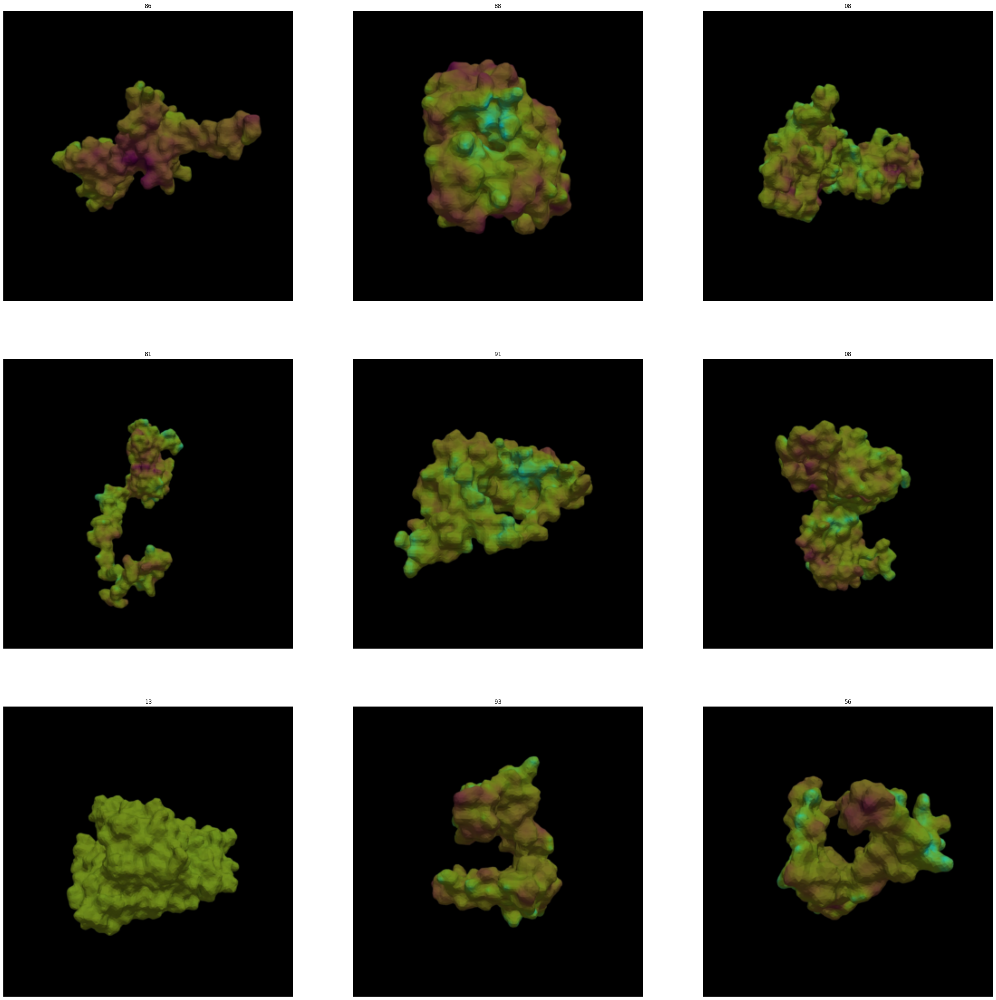

In [173]:
env['data-augmentation'] = 'no-data-aug'
learn = init_learner(env, debug=False)

In [174]:
if env['problem'] == 'classification':
    init_learner = init_learner_classification
    show_batch   = learn.dls.show_batch
    show_results = learn.show_results
if env['problem'] == 'regression':
    init_learner = init_learner_regression
    show_batch   = learn.dls.show_batch
    show_results = learn.show_results

In [175]:
def validate(learn, debug=False):
    neq=50
    print(neq*'=')
    print(neq*'=')
    print(f'Validating, please wait...')
    print(neq*'=')
    metrics = learn.validate()
    if debug:
        print(f'learn.metrics: {learn.metrics}')
        for idx, this_metric in enumerate(learn.metrics):
            print(f'this_metric.name: {this_metric.name}')
        print(f'metrics: {metrics}')
    print(f'Validation completed, printing validation metrics')
    print(neq*'=')
    for idx, metric_score in enumerate(metrics):
        if idx != 0:
            metric_str = str(learn.metrics[idx-1].name)
            print(f'{idx} - {metric_str} = {metric_score}')
        else:
            print(f'{idx} - valid_loss = {metric_score}')
    print(neq*'=')
    print(neq*'=')

In [176]:
import os
def reload_best_model(learn, prefix, debug=False):
    model_dir = learn.path.absolute() / learn.model_dir
    print(f'Looking for {prefix}-*-best models in: {model_dir}')
    print(20*'-')
    files = model_dir.glob(f'{prefix}*-best.pth')
    files = sorted(files, key=os.path.getmtime)
    for i in files:
        print(i)
    print(20*'-')
    print(f'Reloading {i}')
    learn.load(str(i).replace('.pth', ''))
    validate(learn)

In [177]:
def garbage_collect():
    import gc
    gc.collect()
    torch.cuda.empty_cache()

# Define training ground functions

In [178]:
def next_round(env):
    env['train_round'] += 1
    env['img_size']     = [int(env['orig_img_size'][0] / env['img_size_div'][env['train_round']-1])] * 2     
    env['bs']           = env['batch_sizes'][env['train_round']-1]

In [179]:
def do_lr_find_impl(env, learn):
    if env['use_dataparallel']:
        n_gpu = torch.cuda.device_count()
        ctx = learn.parallel_ctx if n_gpu else None
        gpu = None
        
        with partial(ctx, gpu)():
            print(f"LR_finding in {ctx.__name__} context on GPU {list(range(n_gpu))}")
            suggested_lrs = learn.lr_find() # find learning rate
            
        !nvidia-smi
    else:
        suggested_lrs = learn.lr_find()     # find learning rate
    
    learn.recorder                          # plot learning rate graph
    print(f'Suggested LRs: {suggested_lrs}')
    if suggested_lrs is None:
        suggested_lrs = [1e-4, 1e-4]
    return suggested_lrs

In [180]:
def do_lr_find(env, learn, dls):
    learn.dls = dls
    learn.freeze()
    return do_lr_find_impl(env, learn)

In [181]:
def set_lr(env, learn, suggested_lrs):
    # lr_min is the minimum value in the curve plotted by lr_find()   -> this means that it may be 1e-1 or even 1e0 so it's actually 10x or even 100x the "reasonable" lr_max
    # lr_steep is the x coord of the plot where the slope is steepest -> this means that it may be 1e-2 or so, so it's a reasonable value for actual lr_max
    lr_min = min(suggested_lrs[0]/10, 5e-3)
    lr_max = min(suggested_lrs[0]/2,  1e-2)
    lr_min = max(lr_min, 5e-4)
    lr_max = max(lr_max, 1e-3)
    print(f'Setting LRs to: slice({lr_min}, {lr_max})')
    env['lr'] = slice(lr_min, lr_max)
    model_frozen, env['model_frozen_letter'], env['model_frozen_str '] = is_frozen(learn, debug=False)
    get_save_fn(env, debug=True)
    show_hyperparams()

In [182]:
def train_model(env, learn, epochs=10):
    fit_one_cycle(env, learn, epochs=epochs)
    reload_best_model(learn, '-'.join(env['save_fn'].split('-')[:4]))

In [183]:
def do_lr_find_unfreeze(env, learn):
    learn.unfreeze()
    return do_lr_find_impl(env, learn)

In [184]:
def set_lr_unfreeze(env, learn, suggested_lrs):
    lr_min = min(suggested_lrs[0]/10, 1e-5)
    lr_max = min(suggested_lrs[0]/2,  1e-4)
    lr_min = max(lr_min, 1e-5)
    lr_max = max(lr_max, 1e-4)
    print(f'Setting LRs to: slice({lr_min}, {lr_max})')
    env['lr'] = slice(lr_min, lr_max)
    model_frozen, env['model_frozen_letter'], env['model_frozen_str '] = is_frozen(learn, debug=False)
    get_save_fn(env, debug=True)
    show_hyperparams()

In [185]:
def train_model_unfreeze(env, learn, epochs=10):
    fit_one_cycle(env, learn, epochs=epochs)
    reload_best_model(learn, '-'.join(env['save_fn'].split('-')[:4]))

In [186]:
def do_training_round (env, learn, epochs=10):
    next_round(env)
    dls = alloc_datablock(env)
    
    suggested_lrs = do_lr_find(env, learn, dls)
    set_lr(env, learn, suggested_lrs)
    train_model(env, learn, epochs=epochs)
    
    if not env['no-unfreeze']:
        suggested_lrs = do_lr_find_unfreeze(env, learn)
        set_lr_unfreeze(env, learn, suggested_lrs)
        train_model_unfreeze(env, learn, epochs=epochs)

In [187]:
import matplotlib.pyplot as plt

@patch
def confusion_matrix(self: ClassificationInterpretation):
    print(f'Running patched confusion_matrix() method with {self.vocab = }')
    x = torch.arange(0, len(self.vocab)).cuda()
    _,targs,decoded = self.learn.get_preds(dl=self.dl, with_decoded=True, with_preds=True, with_targs=True, act=self.act)
    d,t = flatten_check(decoded, targs)
    cm = ((d==x[:,None]) & (t==x[:,None,None])).long().sum(2)
    return to_np(cm)

def confusion_matrix(learn, title='Confusion Matrix'):
    interp = ClassificationInterpretation.from_learner(learn)
    #interp.plot_confusion_matrix(figsize=(5,5))
    plt.rcParams.update({'font.size': 32})
    disp = interp.plot_confusion_matrix(title=title, cmap=plt.cm.Blues, normalize=False, figsize=(19,18))
    return interp

In [188]:
def validate_against_test_set(env, learn):
    dls_test = alloc_datablock(env, splitter=TestGrandGrandParentSplitter, training_dir=env['training_dir'], valid_dir=env['testing_dir'])
    learn.dls = dls_test
    learn.freeze()
    validate(learn)

In [189]:
learn.model

Sequential(
  (0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
          (0): Conv2d(64, 256

In [190]:
learn.summary()

Sequential (Input shape: 64 x 3 x 320 x 320)
Layer (type)         Output Shape         Param #    Trainable 
                     64 x 64 x 160 x 160 
Conv2d                                    9408       False     
BatchNorm2d                               128        True      
ReLU                                                           
____________________________________________________________________________
                     64 x 64 x 80 x 80   
MaxPool2d                                                      
Conv2d                                    4096       False     
BatchNorm2d                               128        True      
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
____________________________________________________________________________
                     64 x 256 x 80 x 80  
Conv2d                                    16384      False     
BatchNorm2d                        

In [191]:
if env['problem'] == 'regression':
    print(learn.loss_func)

In [68]:
please_stop_here_with_an_error

NameError: name 'please_stop_here_with_an_error' is not defined

# No data Aug


## Round 1

In [193]:
env['train_round']       = 0
env['data-augmentation'] = 'no-data-aug'

In [ ]:
do_training_round(env, learn, epochs=10)

--------------------------------------------------------------------------
Running with no-data-aug - env_['img_size'] = [320, 320] - env_['bs'] = 64
--------------------------------------------------------------------------
Using (<function CategoryBlock at 0x724695df6160>,) as target...
Using <function RandomSplitter.<locals>._inner at 0x7245fd32d800> as splitter...
Setting-up type transforms pipelines
Found 591616 items
2 datasets of sizes 473293,118323
Setting up Pipeline: <lambda> -> PILBase.create
Setting up Pipeline: <lambda> -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}

Building one sample
  Pipeline: <lambda> -> PILBase.create
    starting from
      /mnt/raid1/datasets/shrec-2025-protein-classification/v2-20250331/train-labeled-screenshots/14/7730-14-8rbx_18:W:V_model1-315-90.jpg
    applying <lambda> gives
      /mnt/raid1/datasets/shrec-2025-protein-classification/v2-20250331/train-labeled-screenshots/14/7730-14-8rbx_18:W:V_model1-315-90.jpg
    applying 

Suggested LRs: SuggestedLRs(valley=0.0005754399462603033)
Setting LRs to: slice(0.0005, 0.001)
save_fn = shrec-2025-protein-classification-resnet50--no-data-aug-img_size-320-320-1a-2025-04-04_12.15.05-BS-64-LR-0.0005-0.001
Batch size: 64, image size: [320, 320], learning rate: slice(0.0005, 0.001, None), round: 1 - device_ids: , n_gpu: 1
save_fn = shrec-2025-protein-classification-resnet50--no-data-aug-img_size-320-320-1a-2025-04-04_12.15.05-BS-64-LR-0.0005-0.001


epoch,train_loss,valid_loss,accuracy,precision_score,recall_score,f1_score,jaccard_score,time


### Reload the best model (CurveML paper)

In [88]:
learn.load('/mnt/btrfs-data/venvs/ml-tutorials/py/notebooks/geometric-primitives-classification/curveml-paper/models/cls/geometric-primitives-dataset-v1.0-wo-splines-resnet101--no-data-aug-img_size-250-250-1a-2023-03-28_18.34.03-BS-32-LR-0.0005-0.001-best')

/mnt/btrfs-data/venvs/ml-tutorials/lib/python3.8/site-packages/fastai/learner.py:58: UserWarning: Saved filed doesn't contain an optimizer state.
  elif with_opt: warn("Saved filed doesn't contain an optimizer state.")


### Perform validation against the validation set...

In [89]:
validate(learn)

Validating, please wait...


Validation completed, printing validation metrics
0 - valid_loss = 0.0002023722045123577
1 - accuracy = 0.9999285936355591
2 - precision_score = 0.9999250186057794
3 - recall_score = 0.9999333333333333
4 - f1_score = 0.9999291665958518
5 - jaccard_score = 0.9998583519391128


### Show confusion matrix and top losses for the validation set

In [68]:
if env['problem'] == 'classification':
    print(f'The classification problem has {learn.dls.c} classes: {learn.dls.vocab}')
    interp = confusion_matrix(learn, title='Confusion Matrix for the Validation Set\n')

The classification problem has 8 classes: ['cassinian-oval', 'cissoid', 'citrus', 'egg', 'geom-petal', 'hypocycloid', 'mouth', 'spiral']


RuntimeError: Expected all tensors to be on the same device, but found at least two devices, cuda:0 and cpu!

In [90]:
interp = ClassificationInterpretation.from_learner(learn)

In [91]:
@patch
def confusion_matrix(self: ClassificationInterpretation):
    print(f'Running patched confusion_matrix() method with {self.vocab = }')
    x = torch.arange(0, len(self.vocab)).cuda()
    _,targs,decoded = self.learn.get_preds(dl=self.dl, with_decoded=True, with_preds=True, with_targs=True, act=self.act)
    d,t = flatten_check(decoded, targs)
    cm = ((d==x[:,None]) & (t==x[:,None,None])).long().sum(2)
    return to_np(cm)

Running patched confusion_matrix() method with self.vocab = ['cassinian-oval', 'cissoid', 'citrus', 'egg', 'geom-petal', 'hypocycloid', 'mouth', 'spiral']


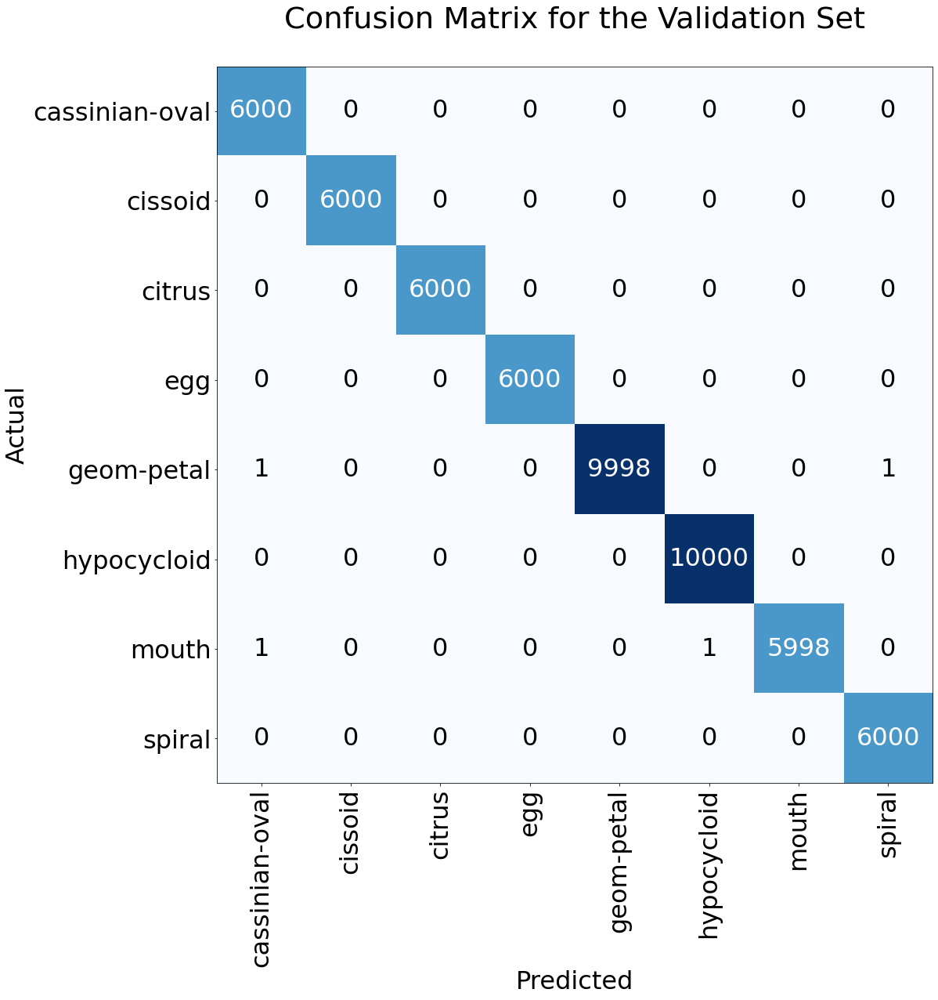

In [92]:
title='Confusion Matrix for the Validation Set\n'
#interp.plot_confusion_matrix(figsize=(5,5))
plt.rcParams.update({'font.size': 32})
disp = interp.plot_confusion_matrix(title=title, cmap=plt.cm.Blues, normalize=False, figsize=(19,18))

/mnt/btrfs-data/venvs/ml-tutorials/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/mnt/btrfs-data/venvs/ml-tutorials/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


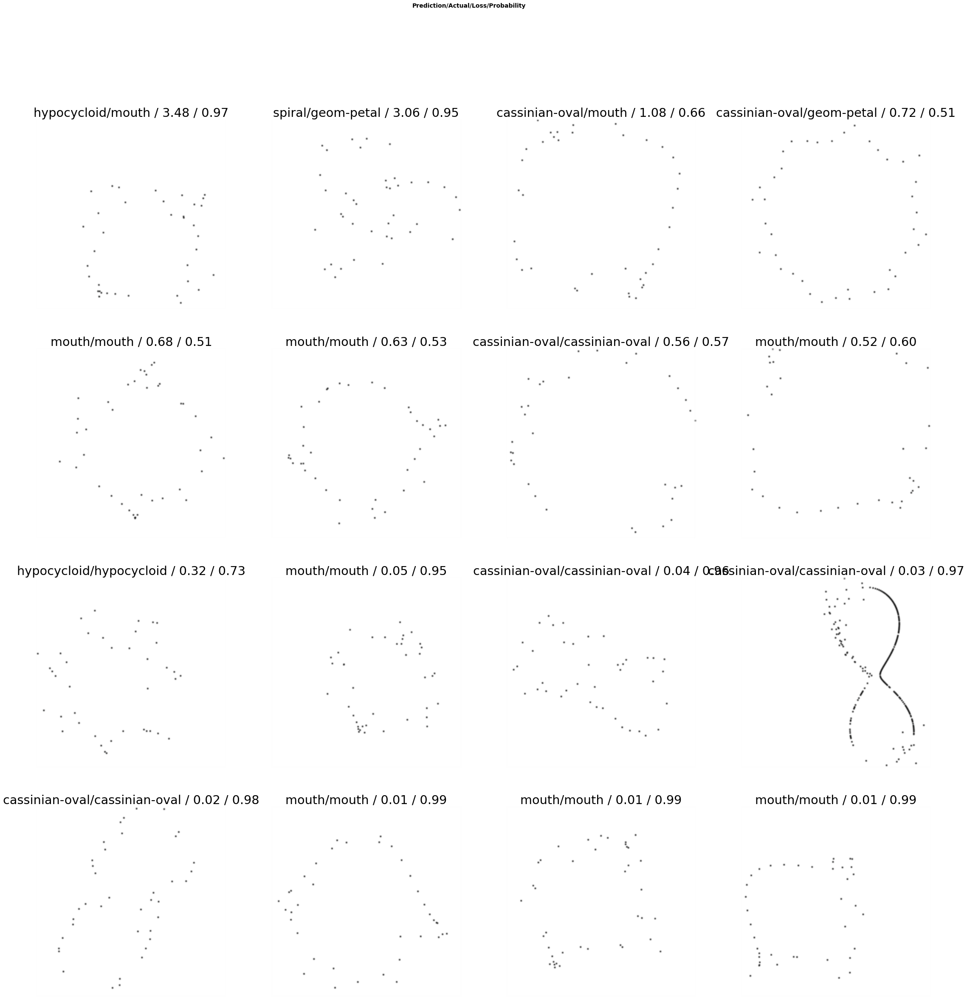

In [94]:
if env['problem'] == 'classification':
    plt.rcParams.update({'font.size': 24})
    interp.plot_top_losses(16, figsize=(38,38), ncols=4, nrows=4, vmin=0, vmax=env['n_classes']-1)

### Show prediction quality against the validation set

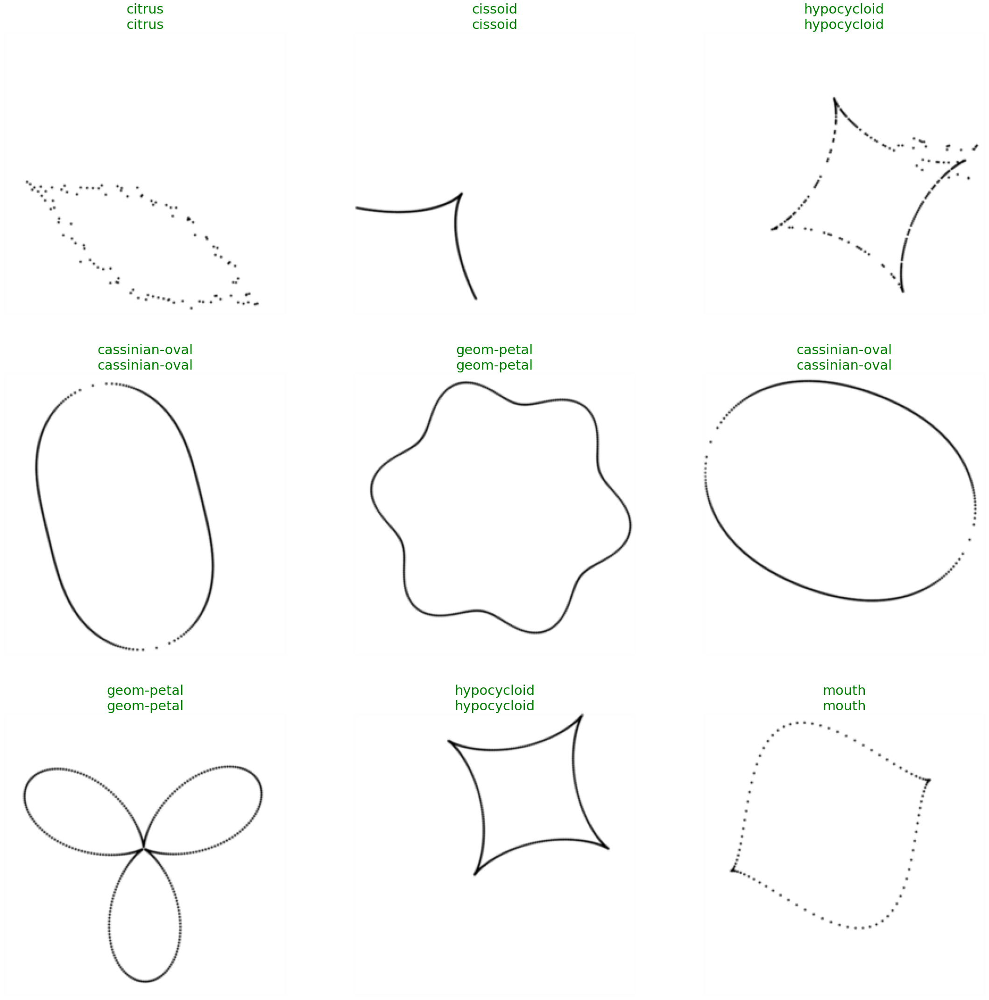

In [95]:
show_results(figsize=(38,38))

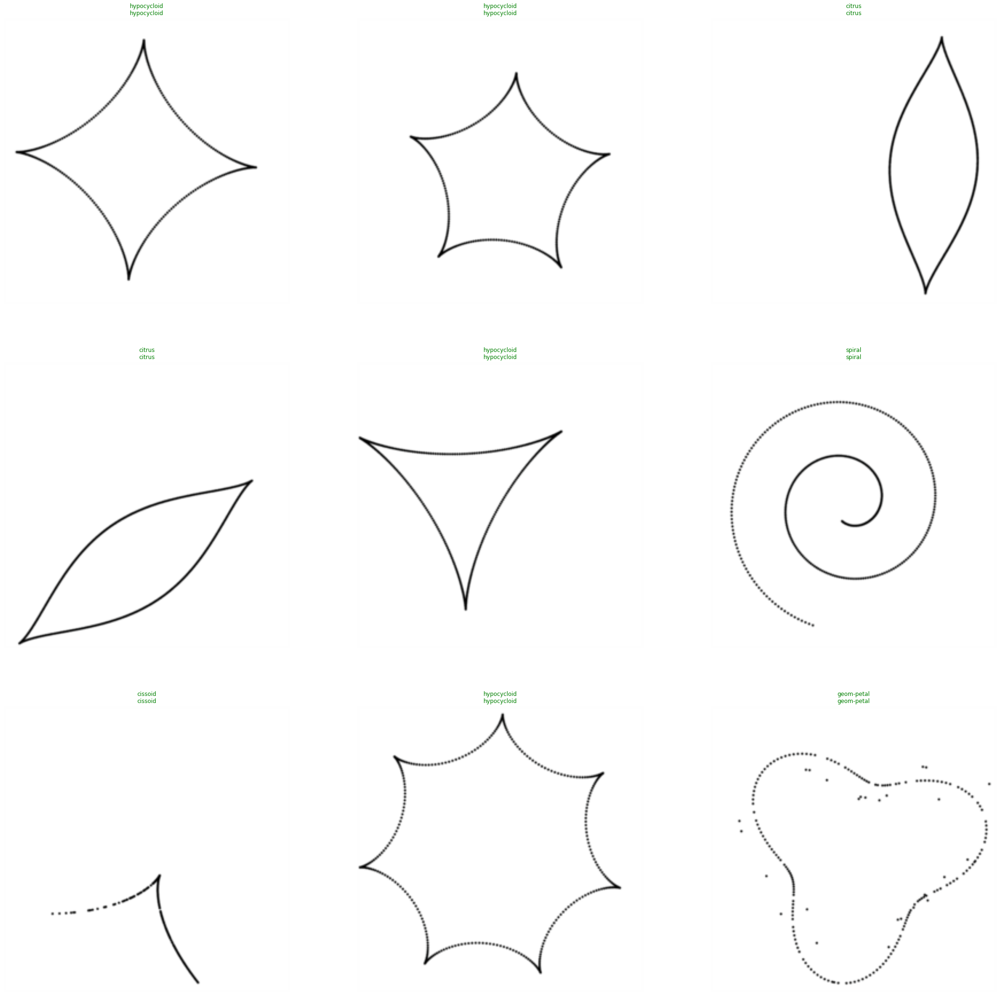

In [75]:
show_results(figsize=(38,38))

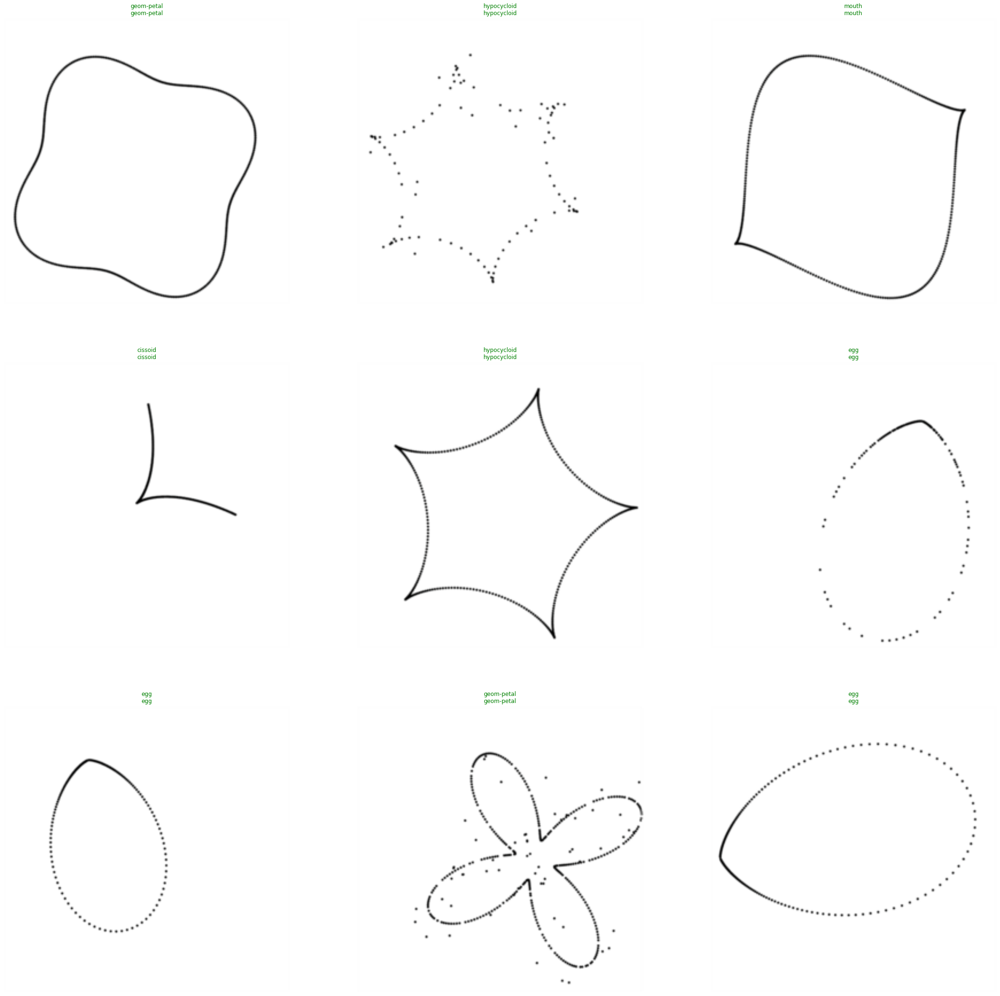

In [76]:
show_results(figsize=(38,38))

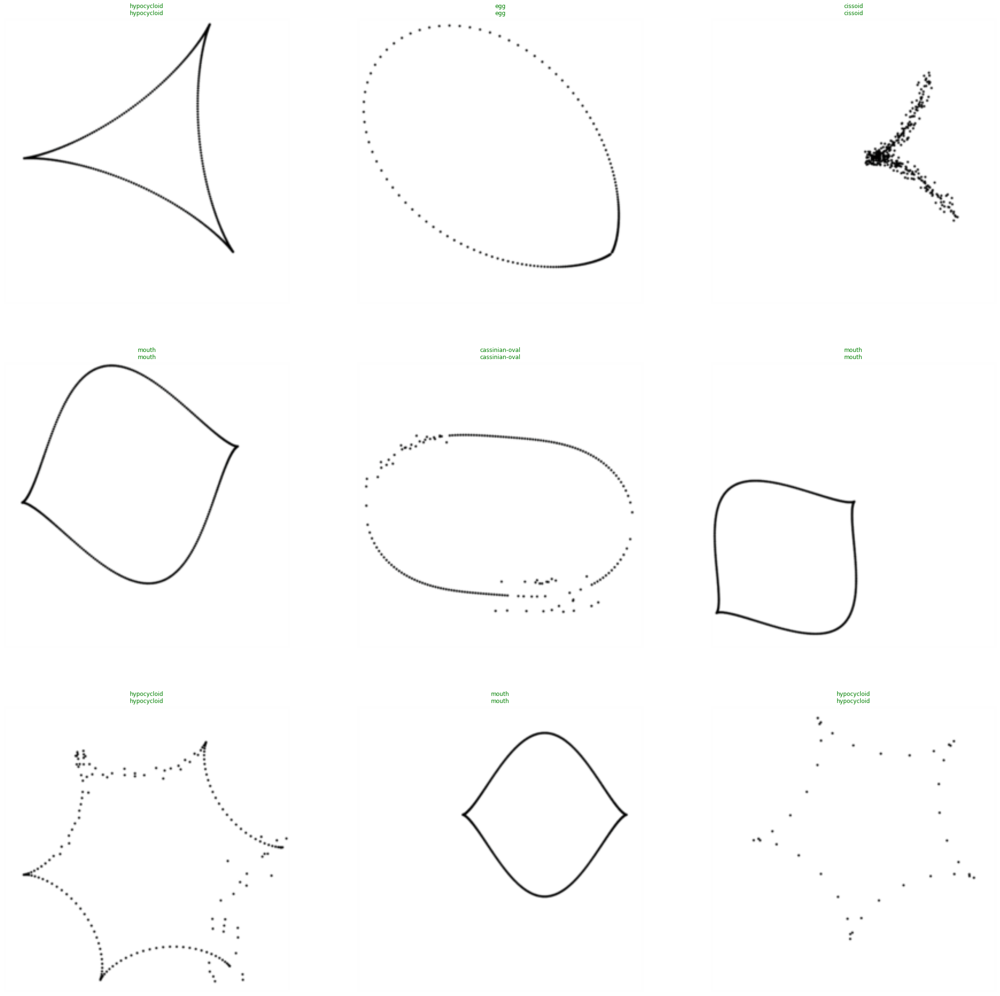

In [77]:
show_results(figsize=(38,38))

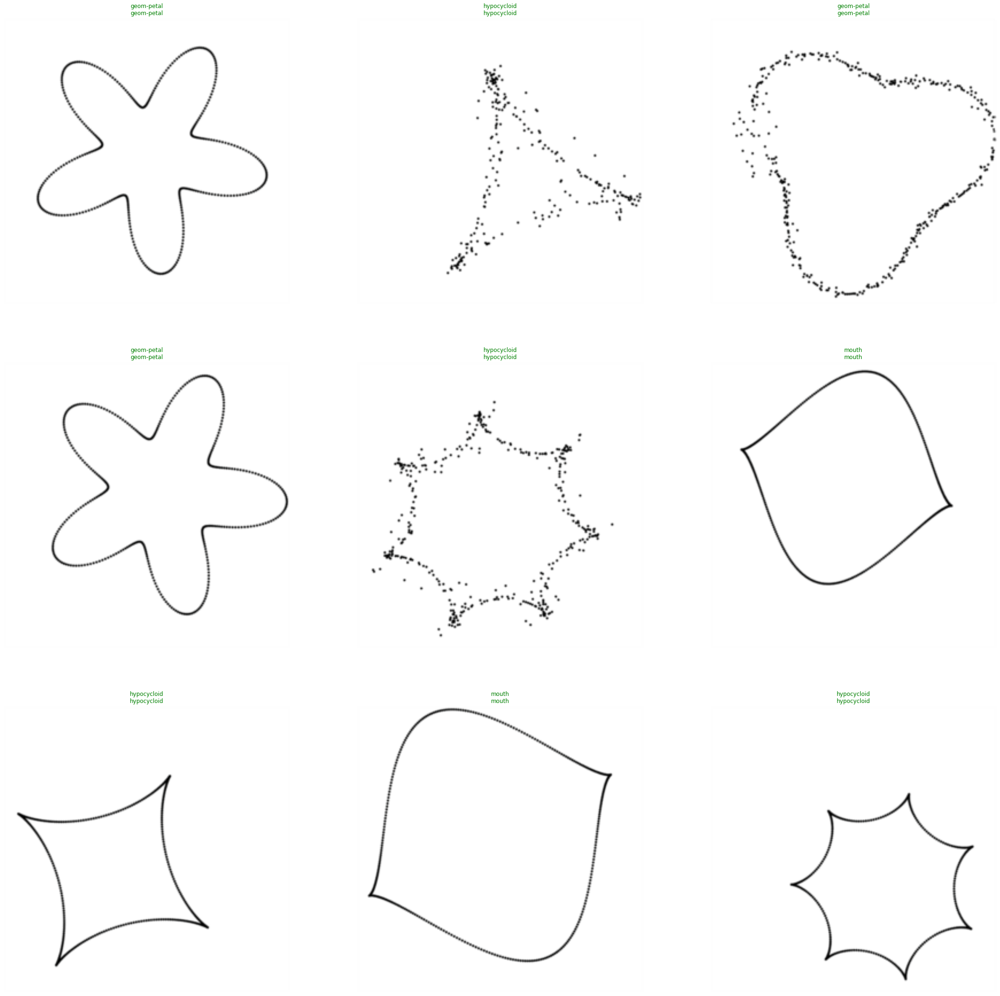

In [78]:
show_results(figsize=(38,38))

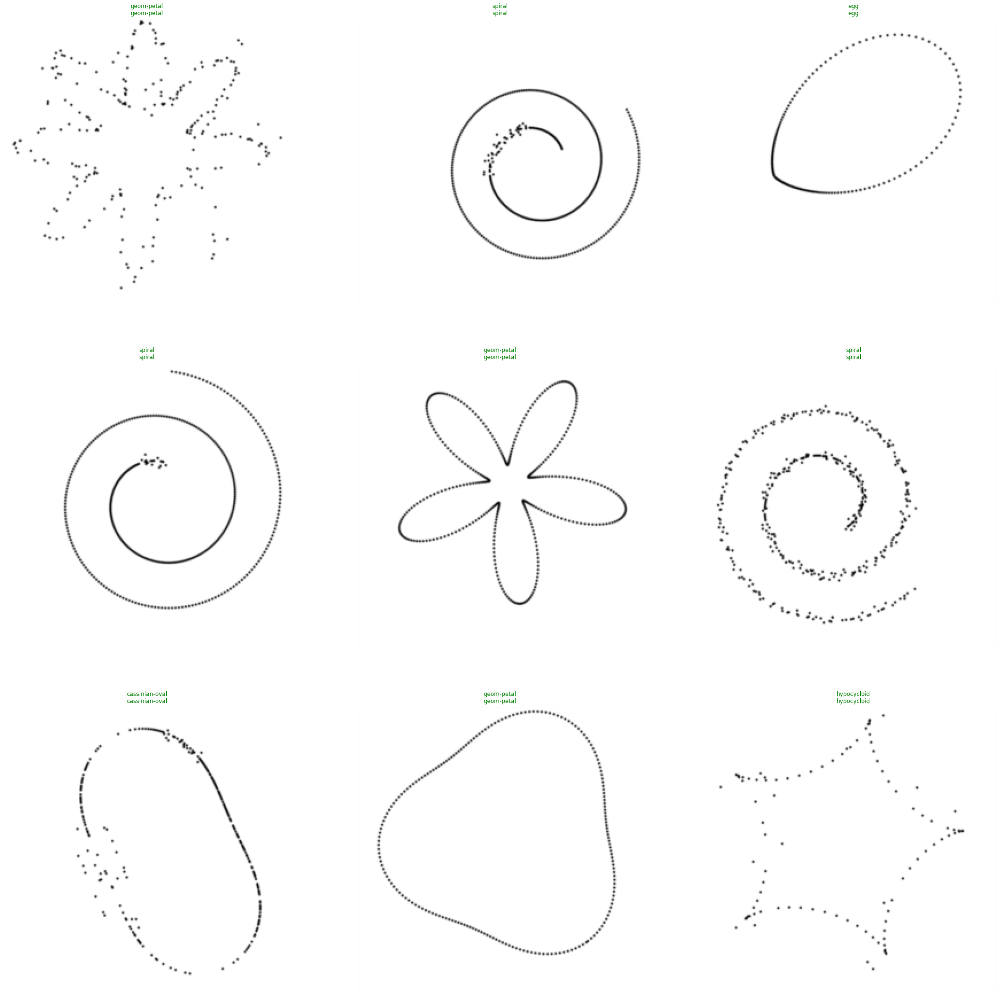

In [79]:
show_results(figsize=(38,38))

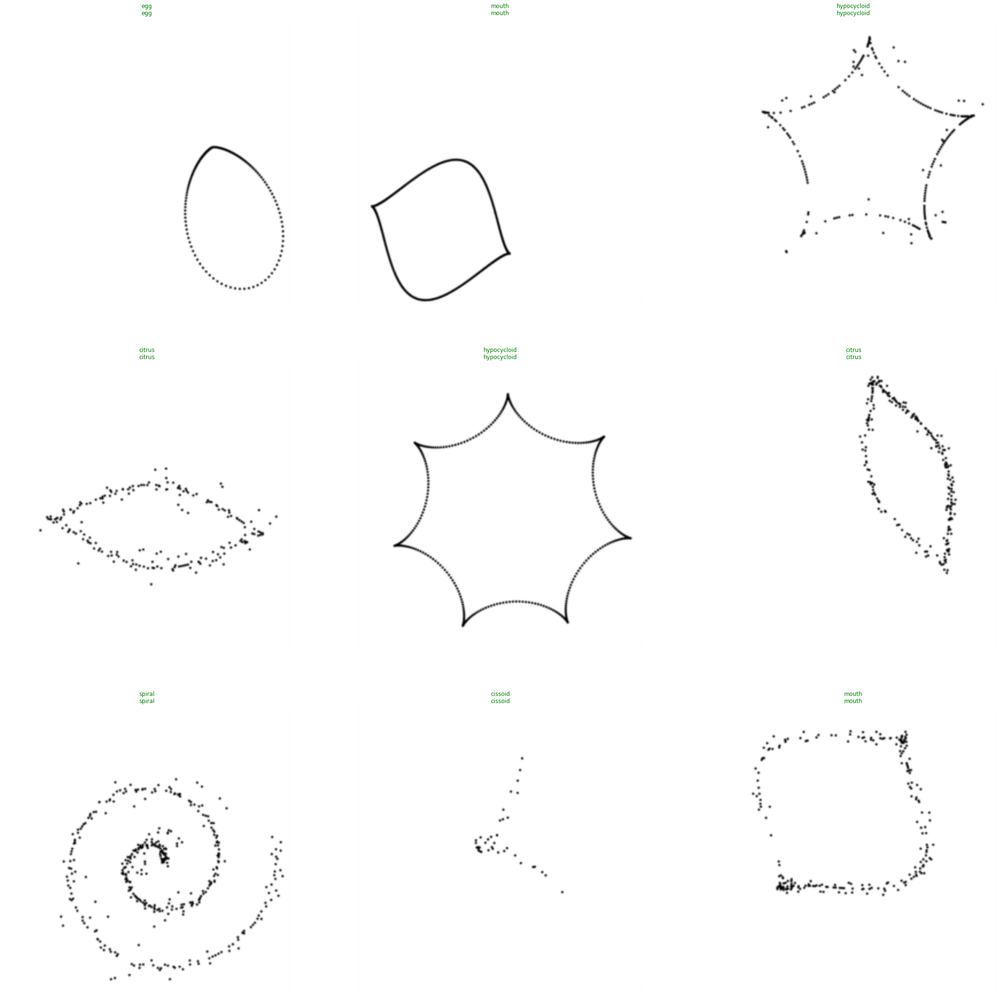

In [80]:
show_results(figsize=(38,38))

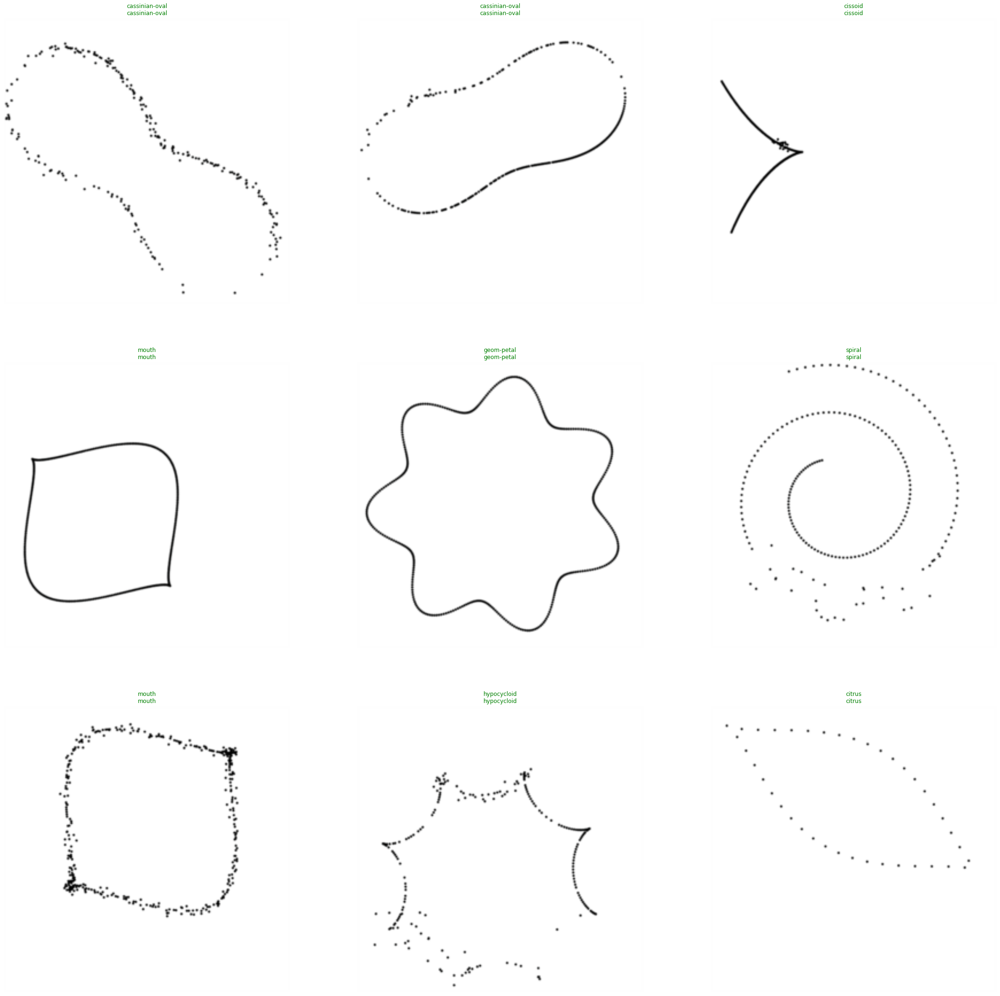

In [81]:
show_results(figsize=(38,38))

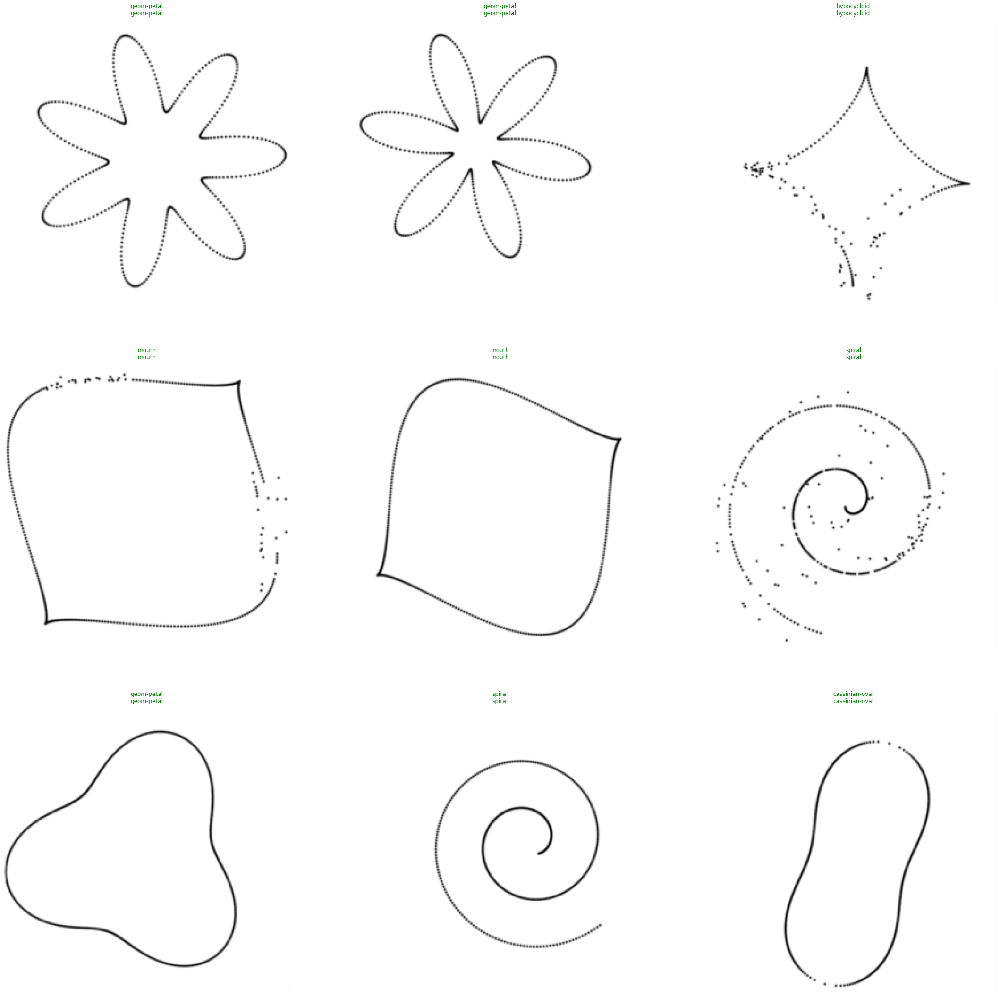

In [82]:
show_results(figsize=(38,38))

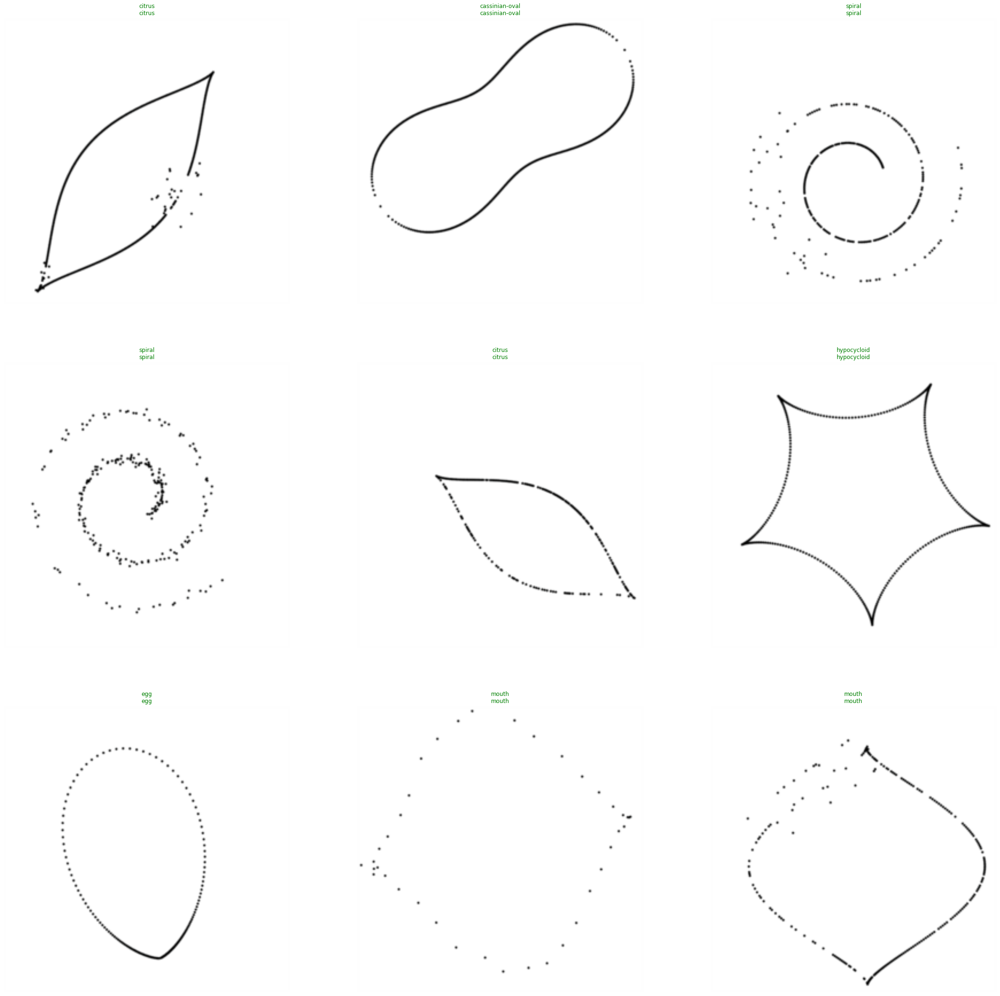

In [83]:
show_results(figsize=(38,38))

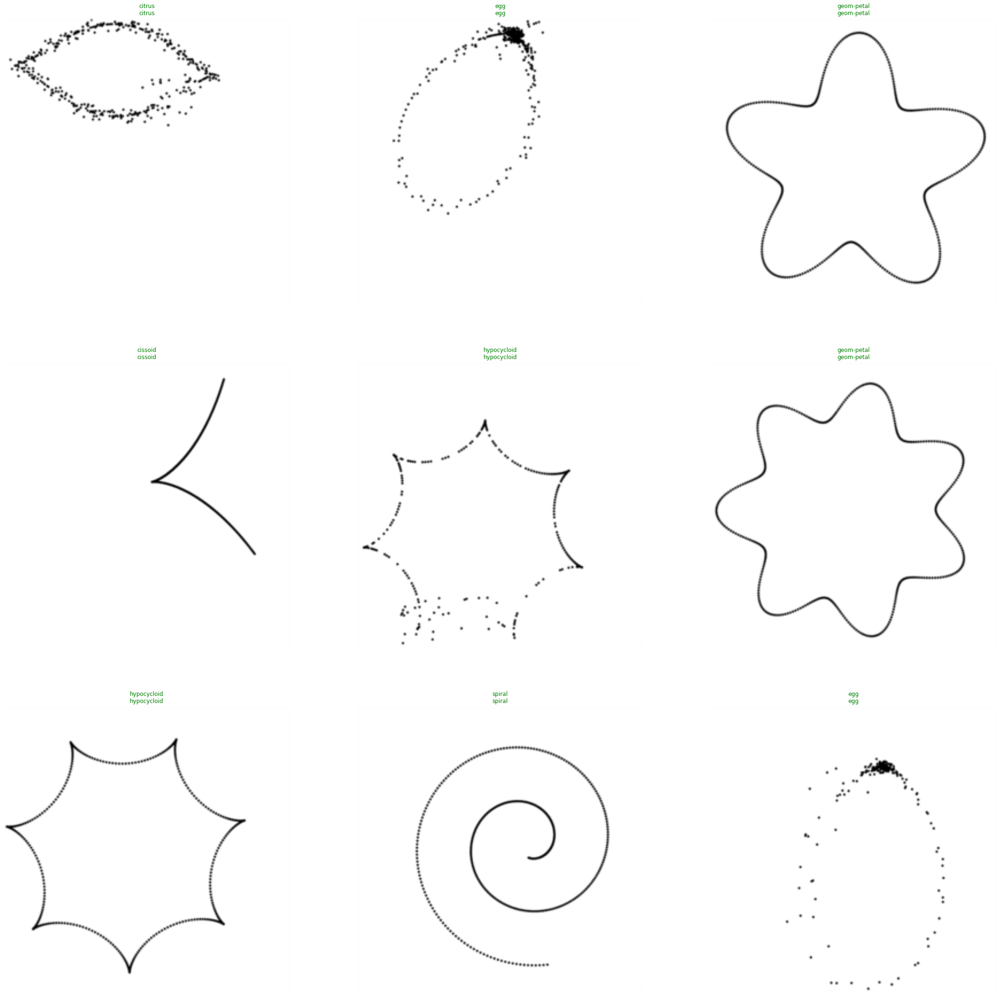

In [84]:
show_results(figsize=(38,38))

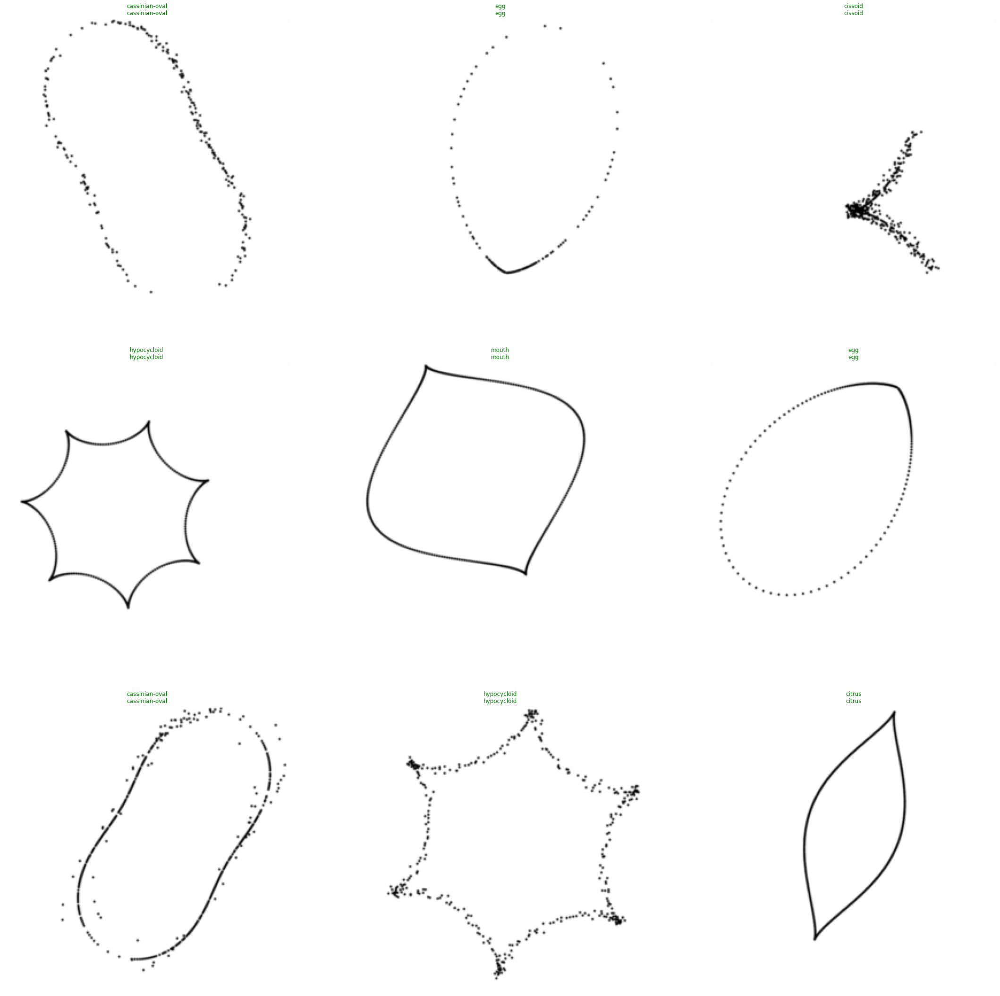

In [85]:
show_results(figsize=(38,38))

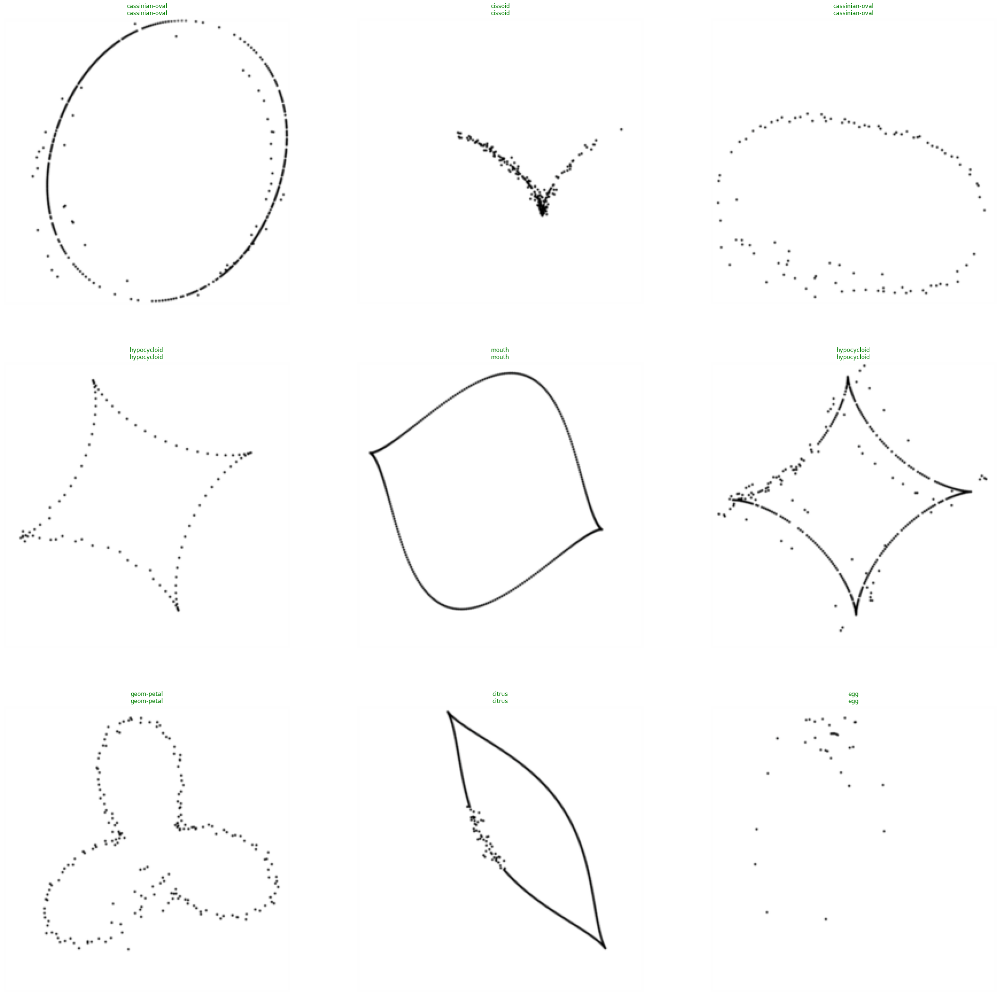

In [86]:
show_results(figsize=(38,38))

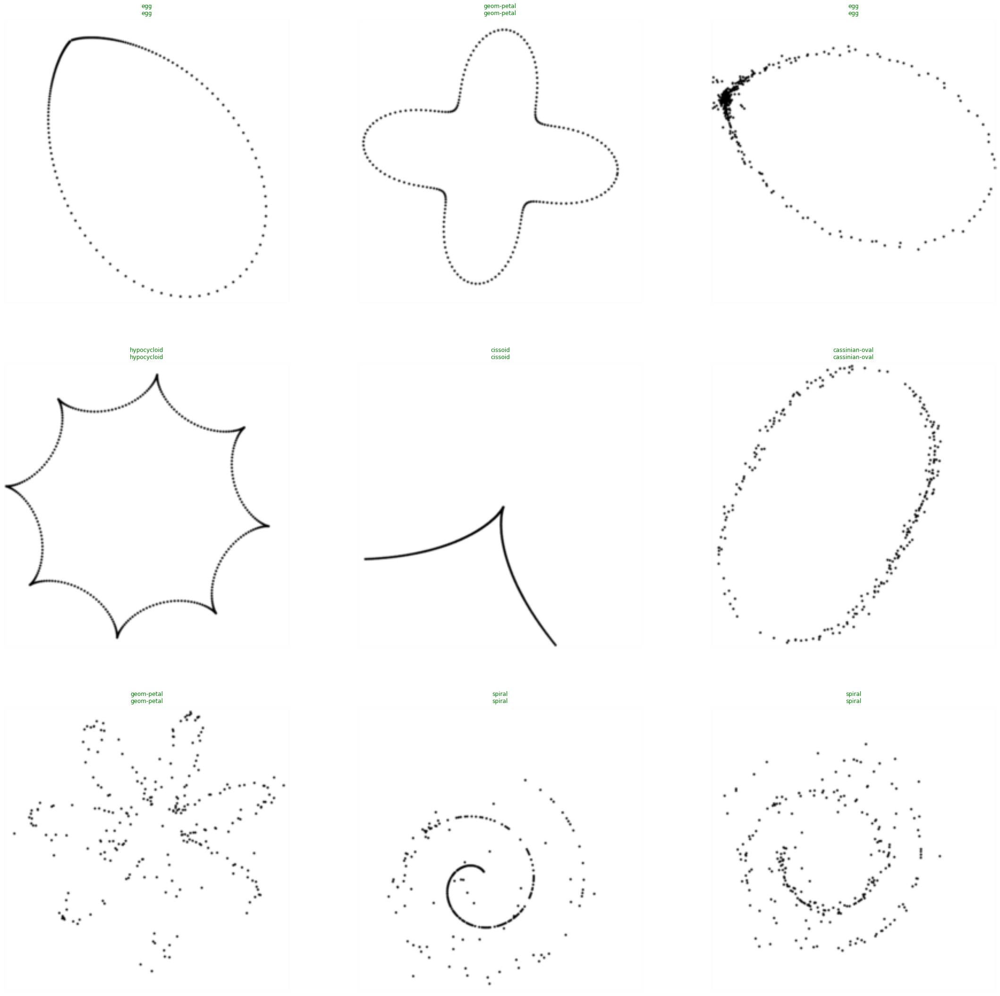

In [87]:
show_results(figsize=(38,38))

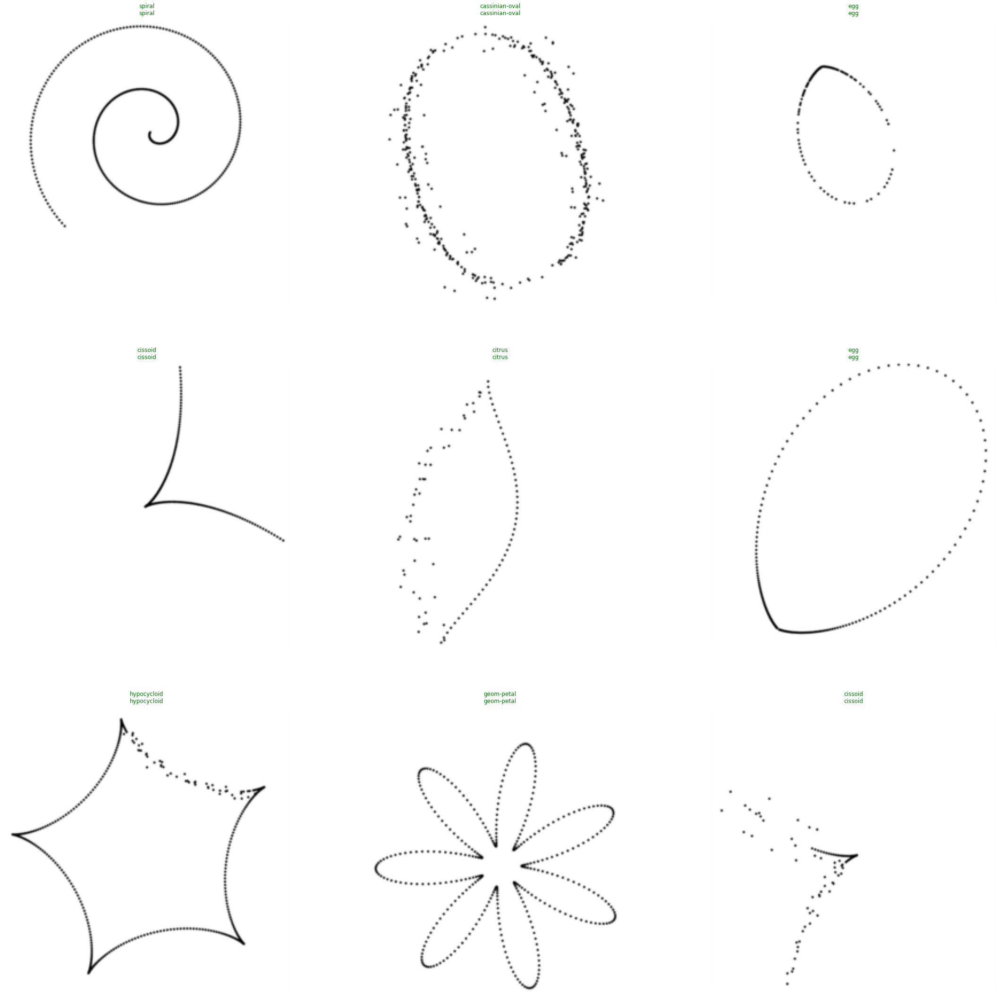

In [88]:
show_results(figsize=(38,38))

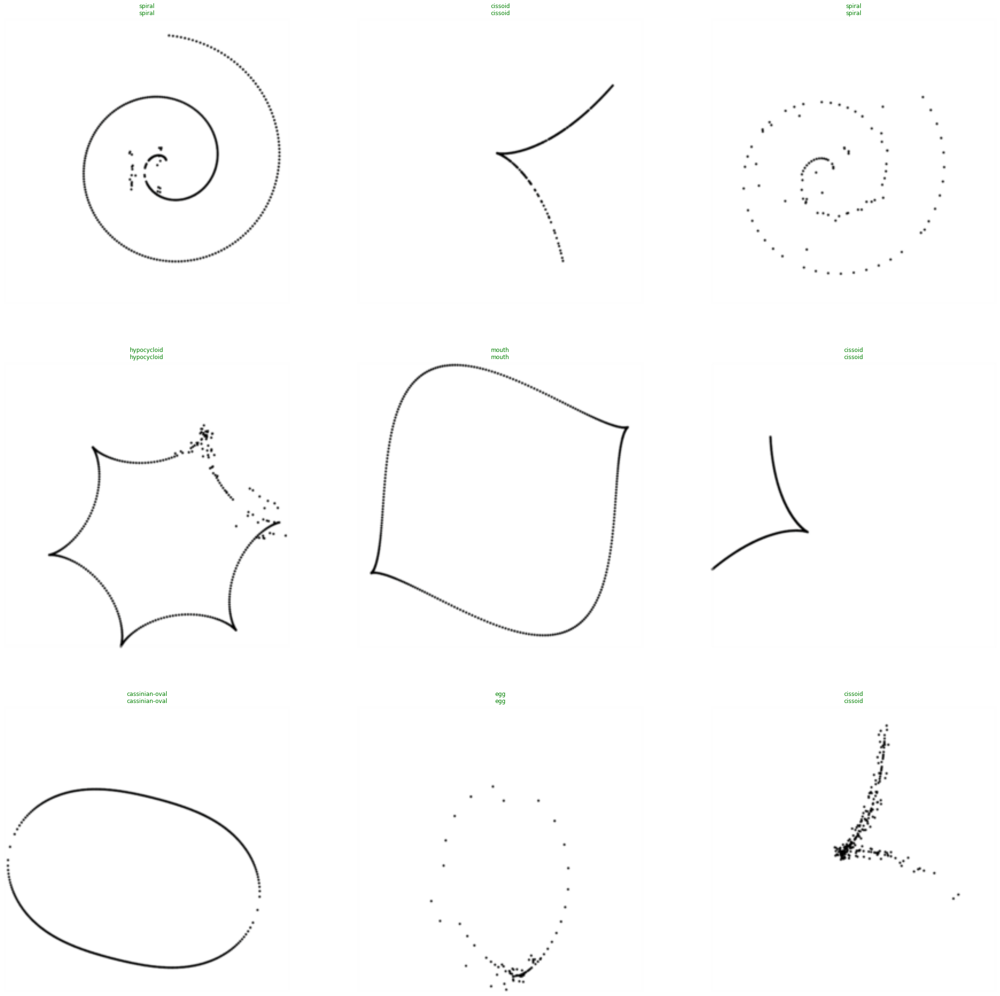

In [89]:
show_results(figsize=(38,38))

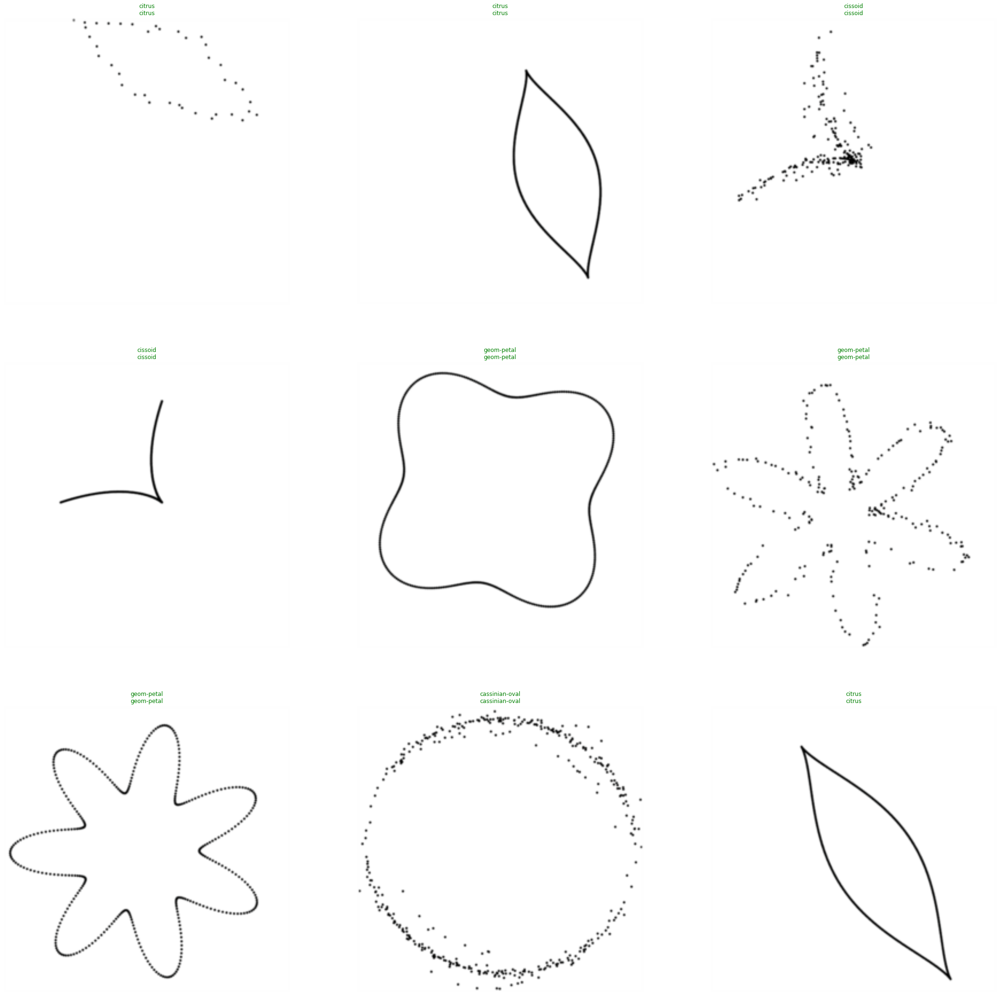

In [90]:
show_results(figsize=(38,38))

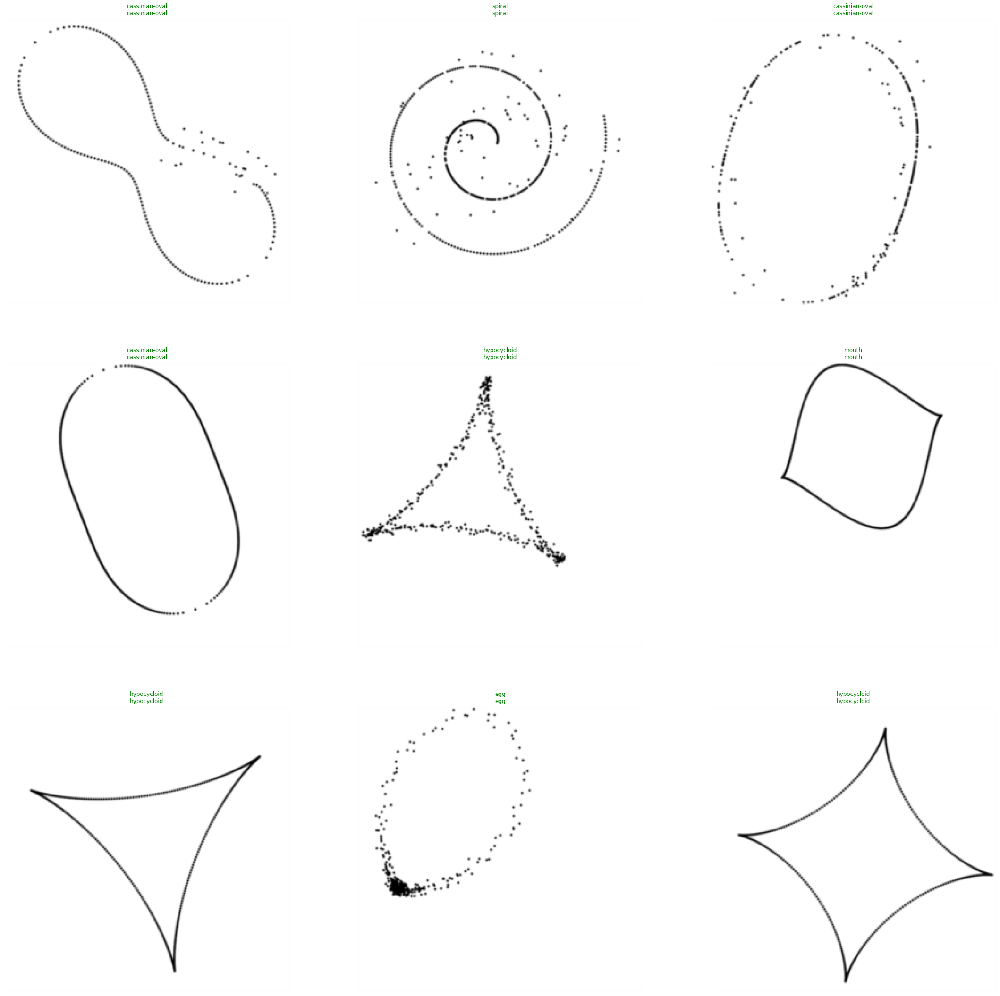

In [91]:
show_results(figsize=(38,38))

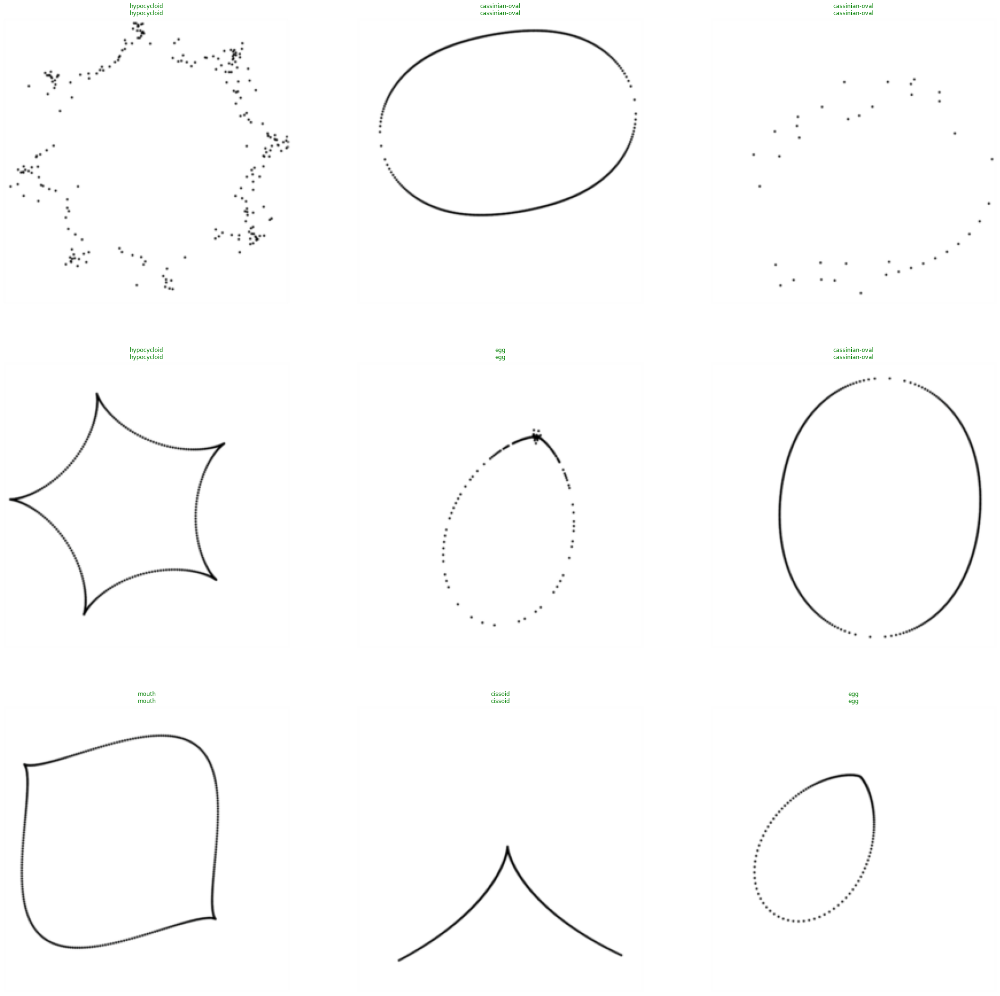

In [92]:
show_results(figsize=(38,38))

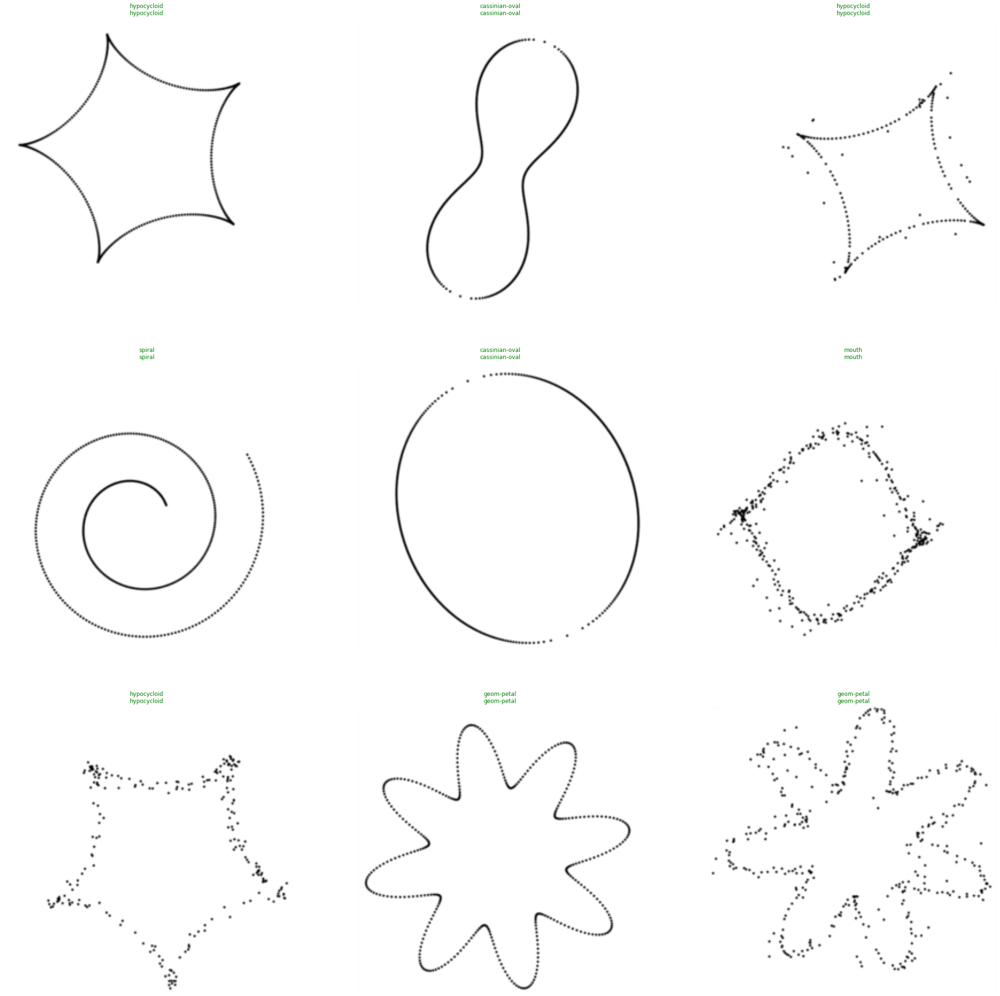

In [93]:
show_results(figsize=(38,38))

### Now perform validation against the test set...

In [75]:
validate_against_test_set(env, learn)

--------------------------------------------------------------------------
Running with no-data-aug - env_['img_size'] = [250, 250] - env_['bs'] = 32
--------------------------------------------------------------------------
Setting-up type transforms pipelines
Found 504000 items
2 datasets of sizes 448000,56000
Setting up Pipeline: <lambda> -> PILBase.create
Setting up Pipeline: <lambda> -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}

Building one sample
  Pipeline: <lambda> -> PILBase.create
    starting from
      /tmp/geometric-primitives-classification/geometric-primitives-dataset-v1.0-wo-splines/training/cassinian-oval/000001/points_clean.png
    applying <lambda> gives
      /tmp/geometric-primitives-classification/geometric-primitives-dataset-v1.0-wo-splines/training/cassinian-oval/000001/points_clean.png
    applying PILBase.create gives
      PILImage mode=RGB size=500x500
  Pipeline: <lambda> -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
  

Validation completed, printing validation metrics
0 - valid_loss = 0.0003260725934524089
1 - accuracy = 0.9998928308486938
2 - precision_score = 0.9999083313855734
3 - recall_score = 0.9998916666666666
4 - f1_score = 0.999899994304273
5 - jaccard_score = 0.9998000358268623


### Show confusion matrix and top losses for the test set

The classification problem has 8 classes: ['cassinian-oval', 'cissoid', 'citrus', 'egg', 'geom-petal', 'hypocycloid', 'mouth', 'spiral']


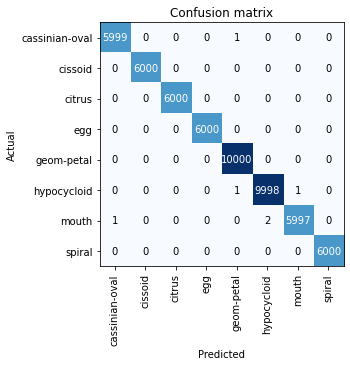

In [95]:
if env['problem'] == 'classification':
    print(f'The classification problem has {learn.dls.c} classes: {learn.dls.vocab}')
    interp = confusion_matrix(learn, title='Confusion Matrix for the Test Set\n')

In [76]:
interp = ClassificationInterpretation.from_learner(learn)

Running patched confusion_matrix() method with self.vocab = ['cassinian-oval', 'cissoid', 'citrus', 'egg', 'geom-petal', 'hypocycloid', 'mouth', 'spiral']


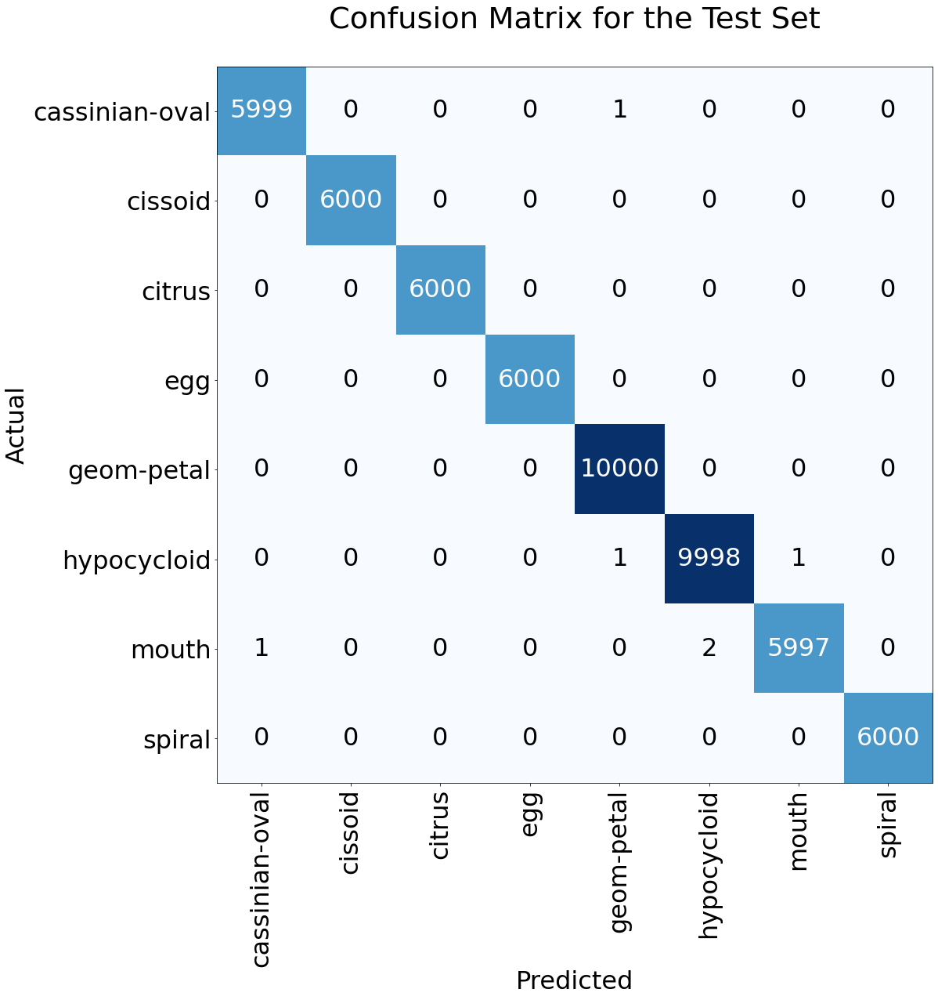

In [81]:
title='Confusion Matrix for the Test Set\n'
#interp.plot_confusion_matrix(figsize=(5,5))
plt.rcParams.update({'font.size': 32})
disp = interp.plot_confusion_matrix(title=title, cmap=plt.cm.Blues, normalize=False, figsize=(19,18))

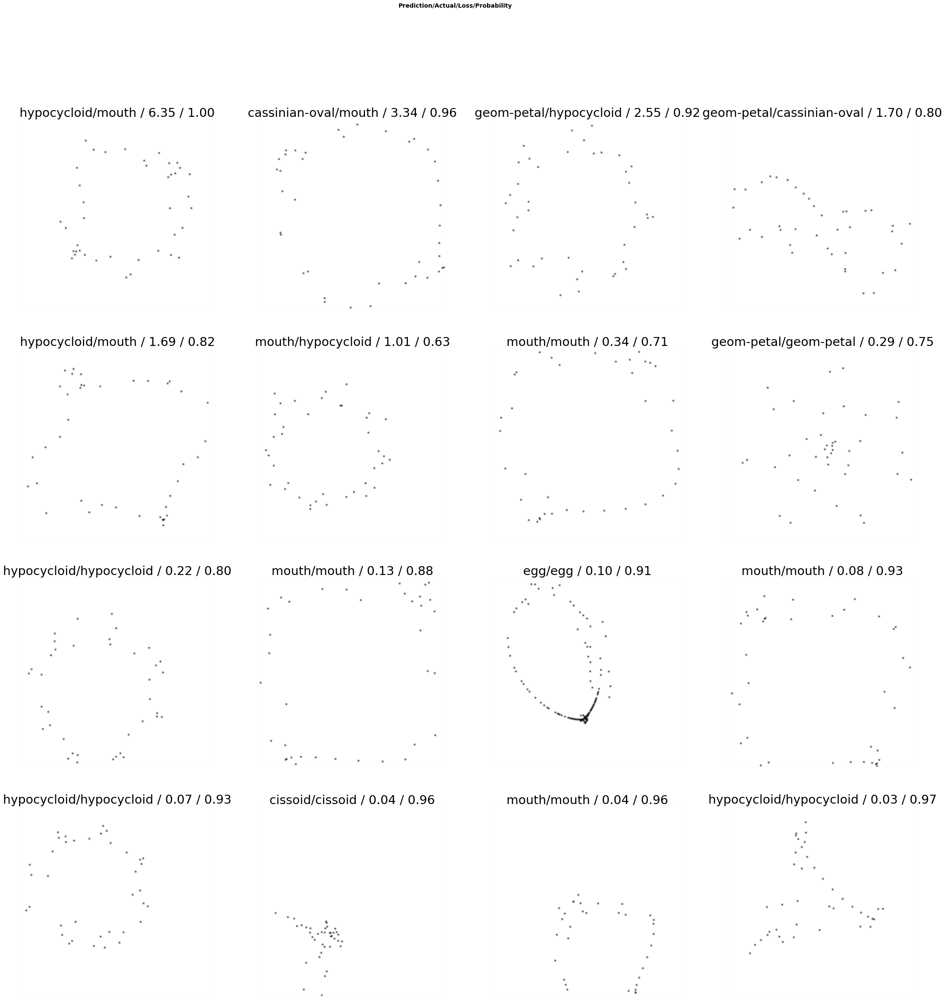

In [80]:
if env['problem'] == 'classification':
    plt.rcParams.update({'font.size': 24})
    interp.plot_top_losses(16, figsize=(38,38), ncols=4, nrows=4, vmin=0, vmax=env['n_classes']-1)

### Show prediction quality against the test set

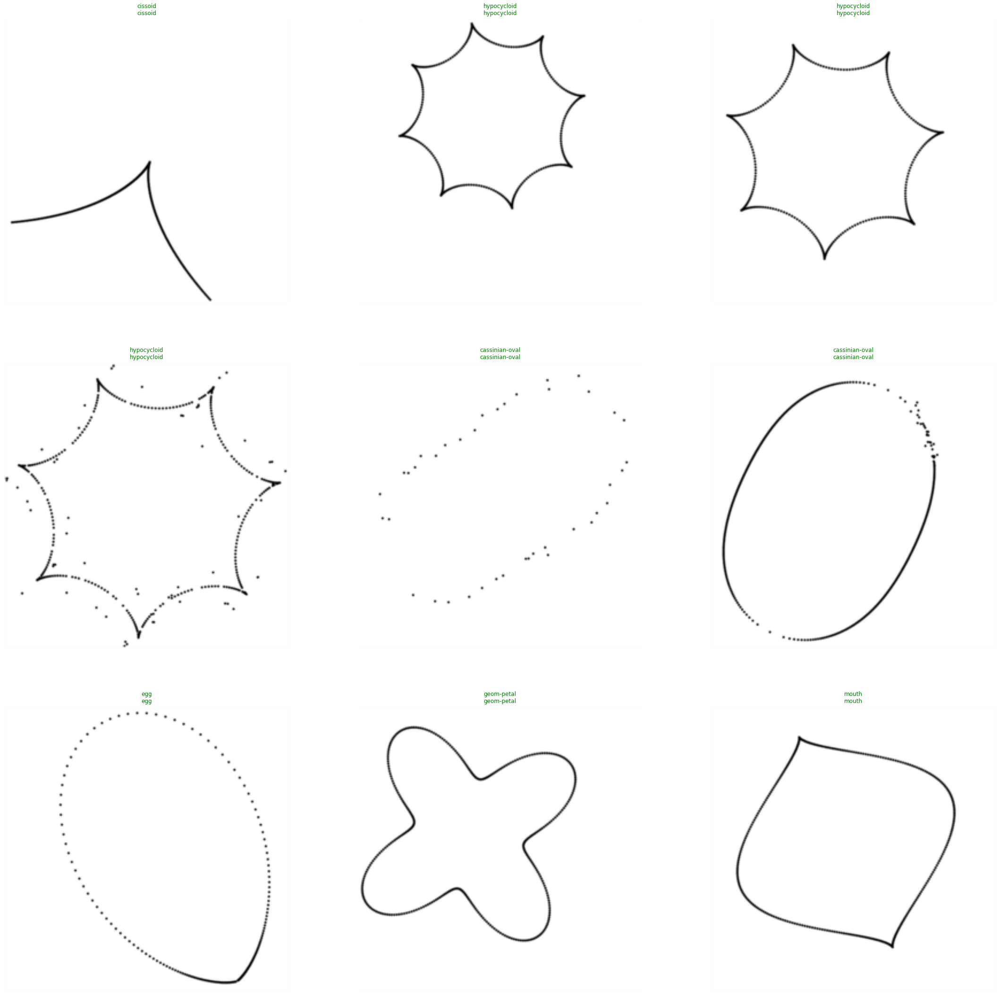

In [97]:
show_results(figsize=(38,38))

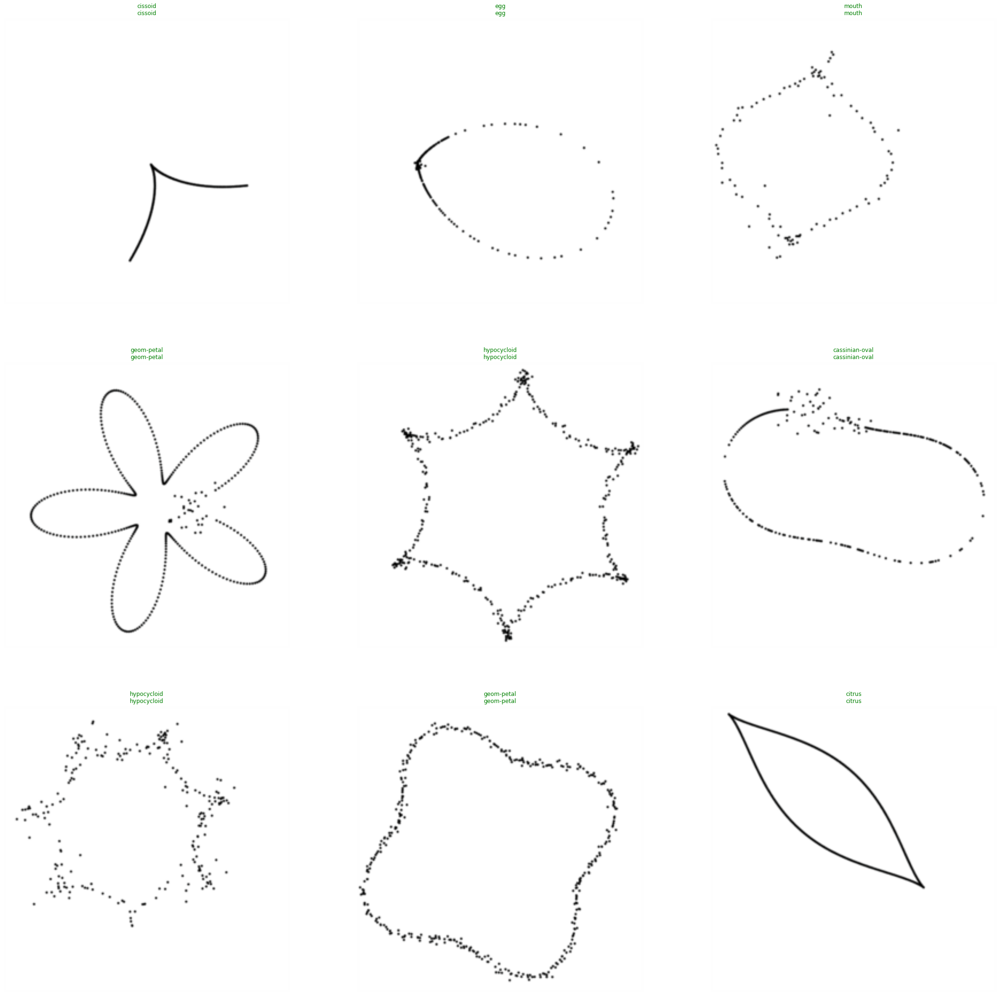

In [98]:
show_results(figsize=(38,38))

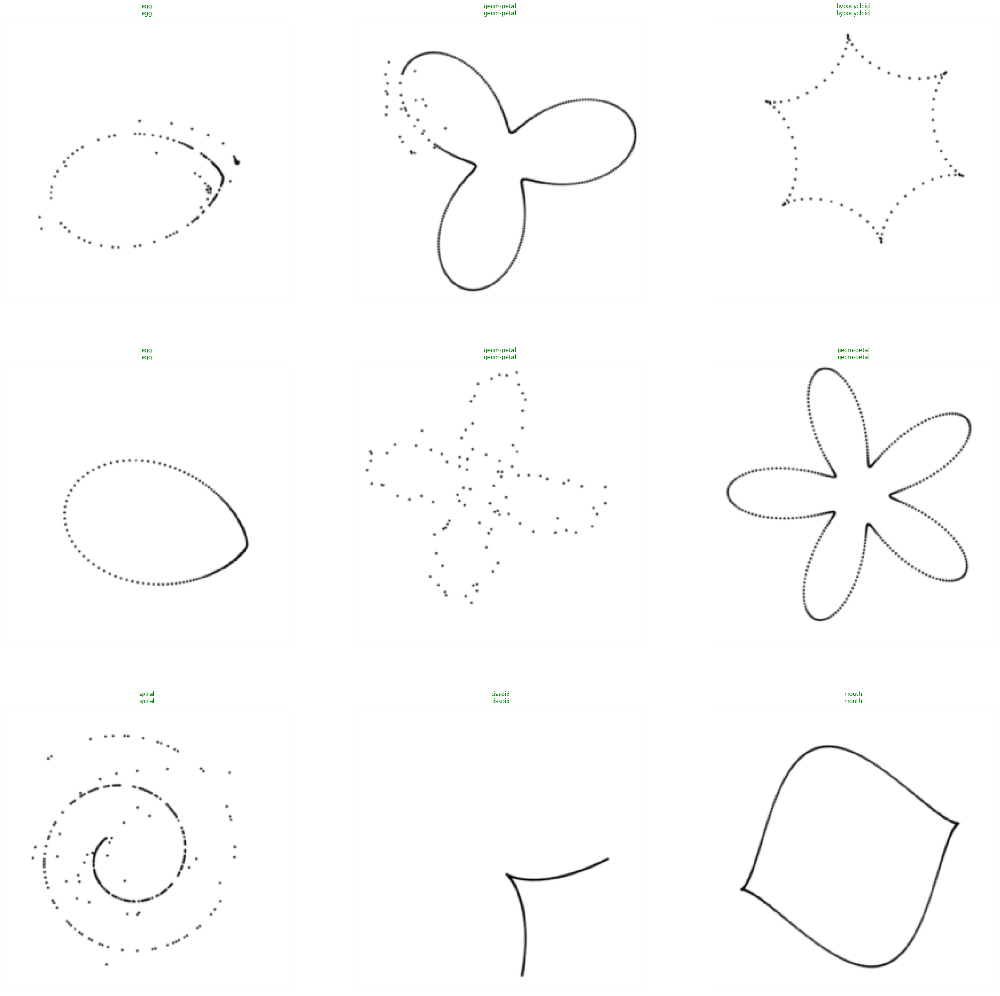

In [99]:
show_results(figsize=(38,38))

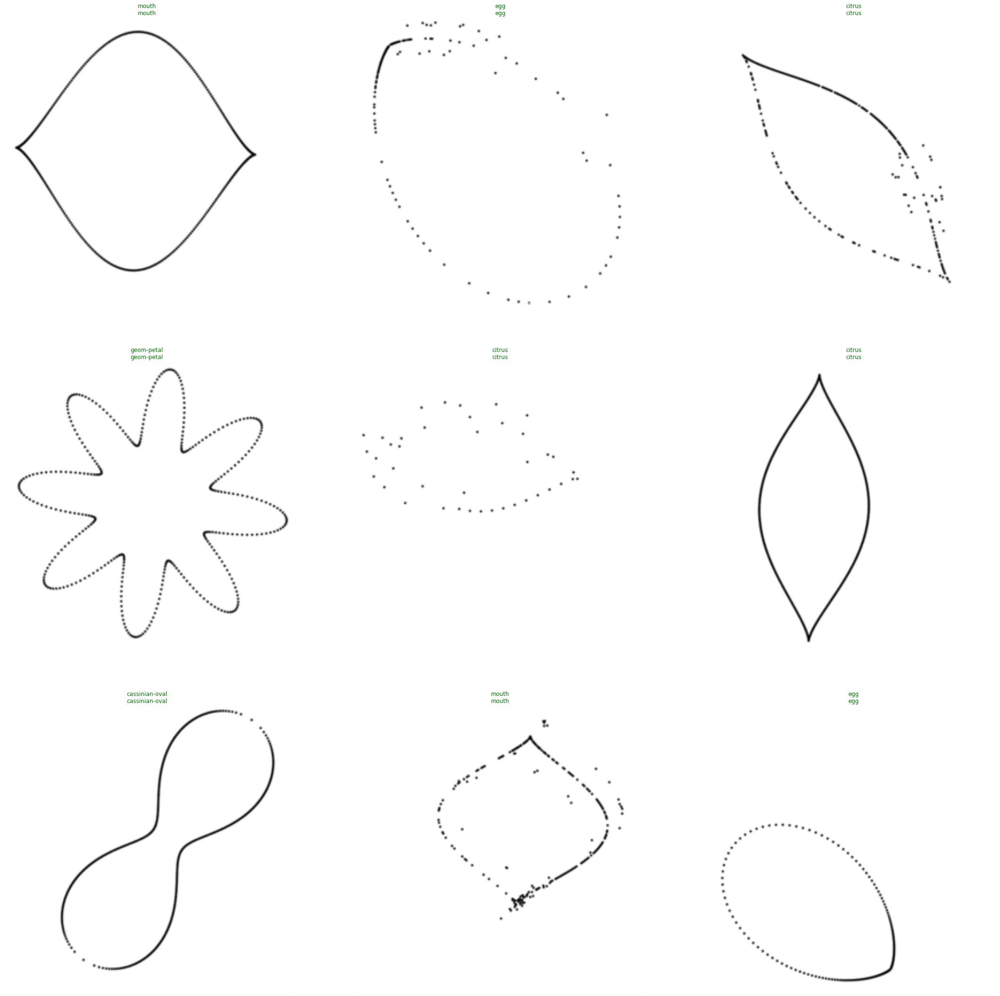

In [100]:
show_results(figsize=(38,38))

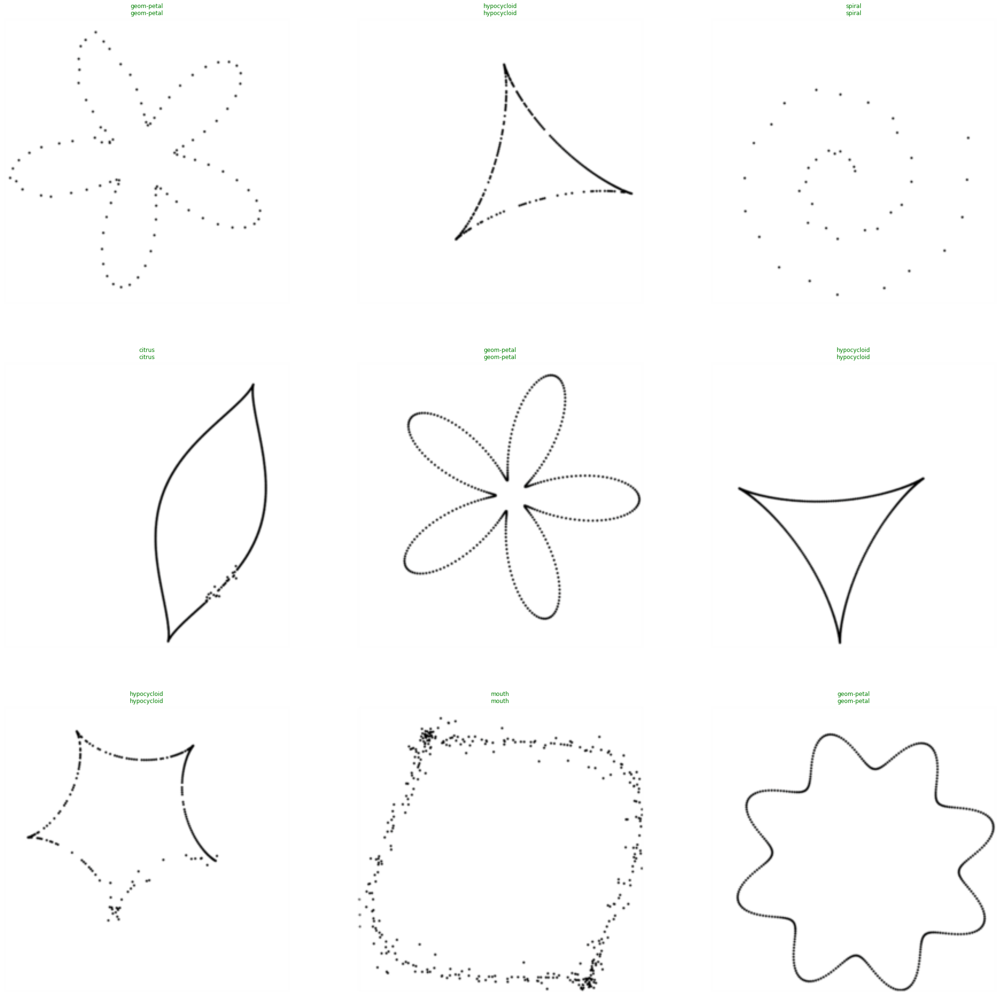

In [101]:
show_results(figsize=(38,38))

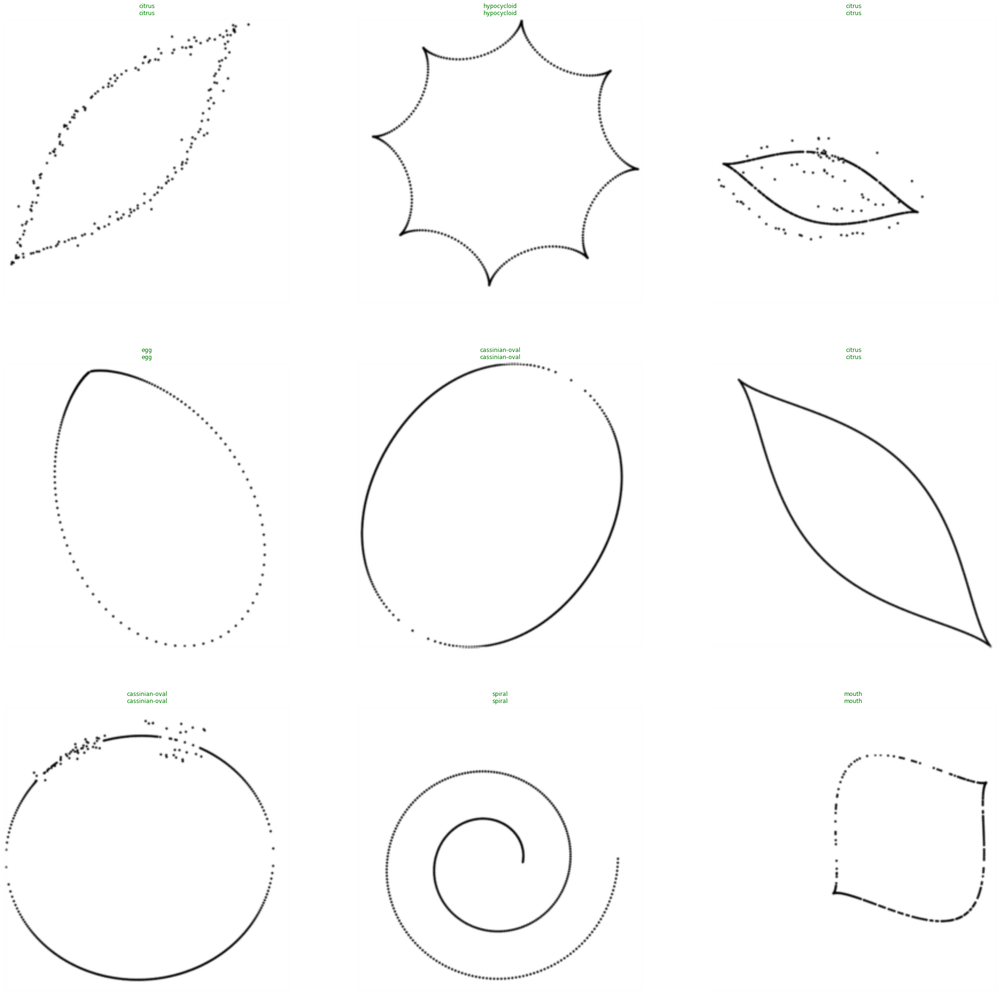

In [102]:
show_results(figsize=(38,38))

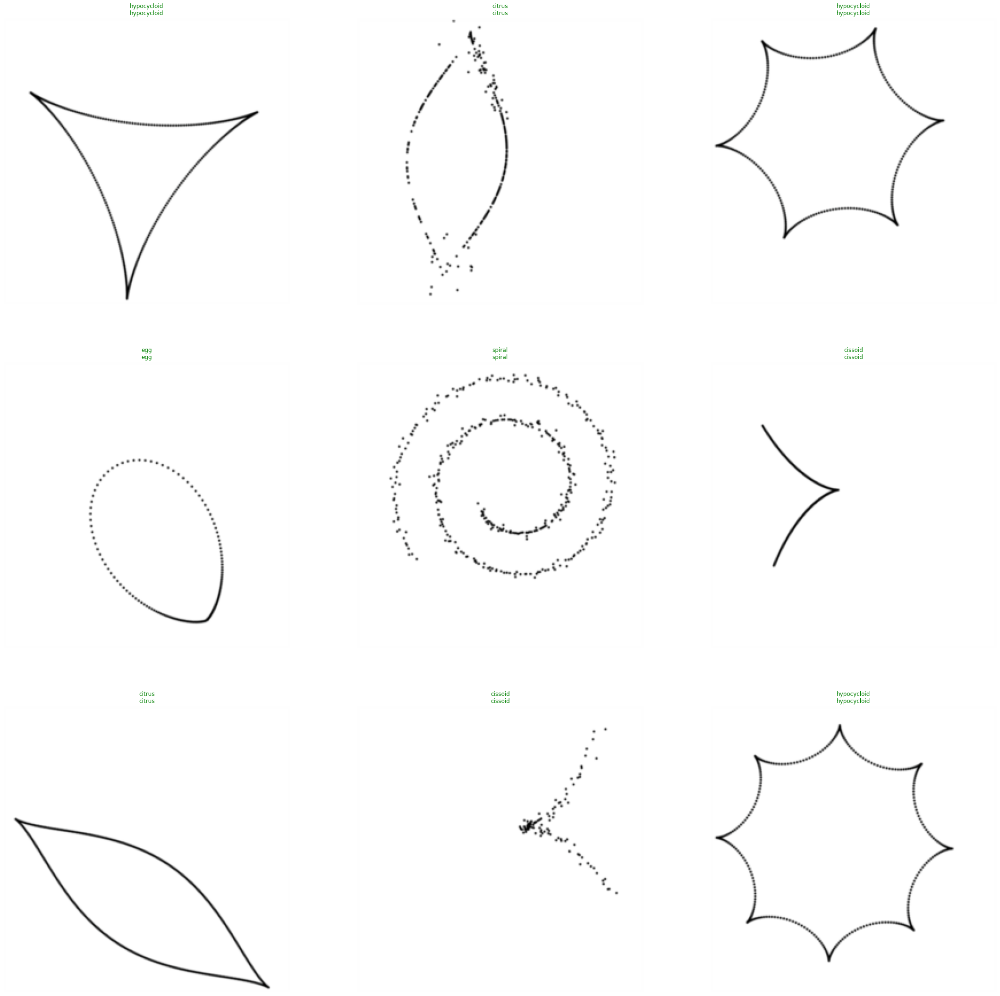

In [103]:
show_results(figsize=(38,38))

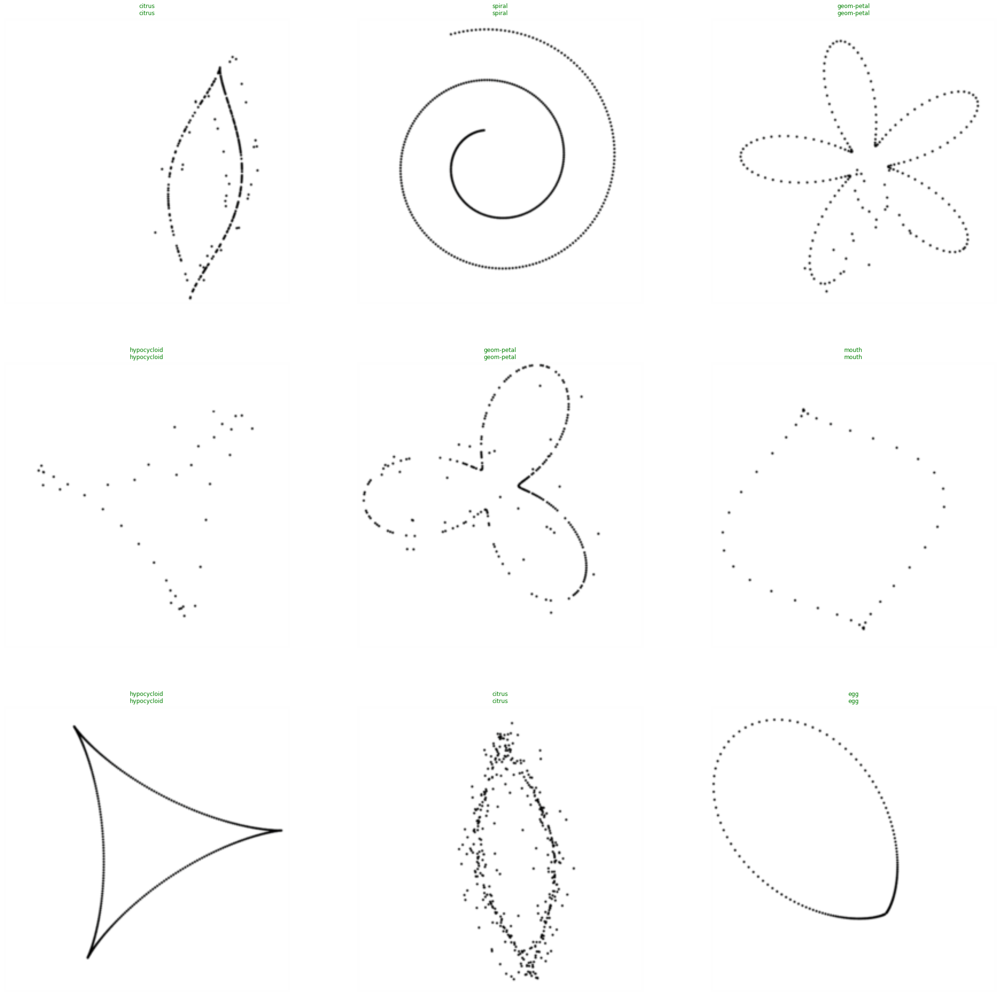

In [104]:
show_results(figsize=(38,38))

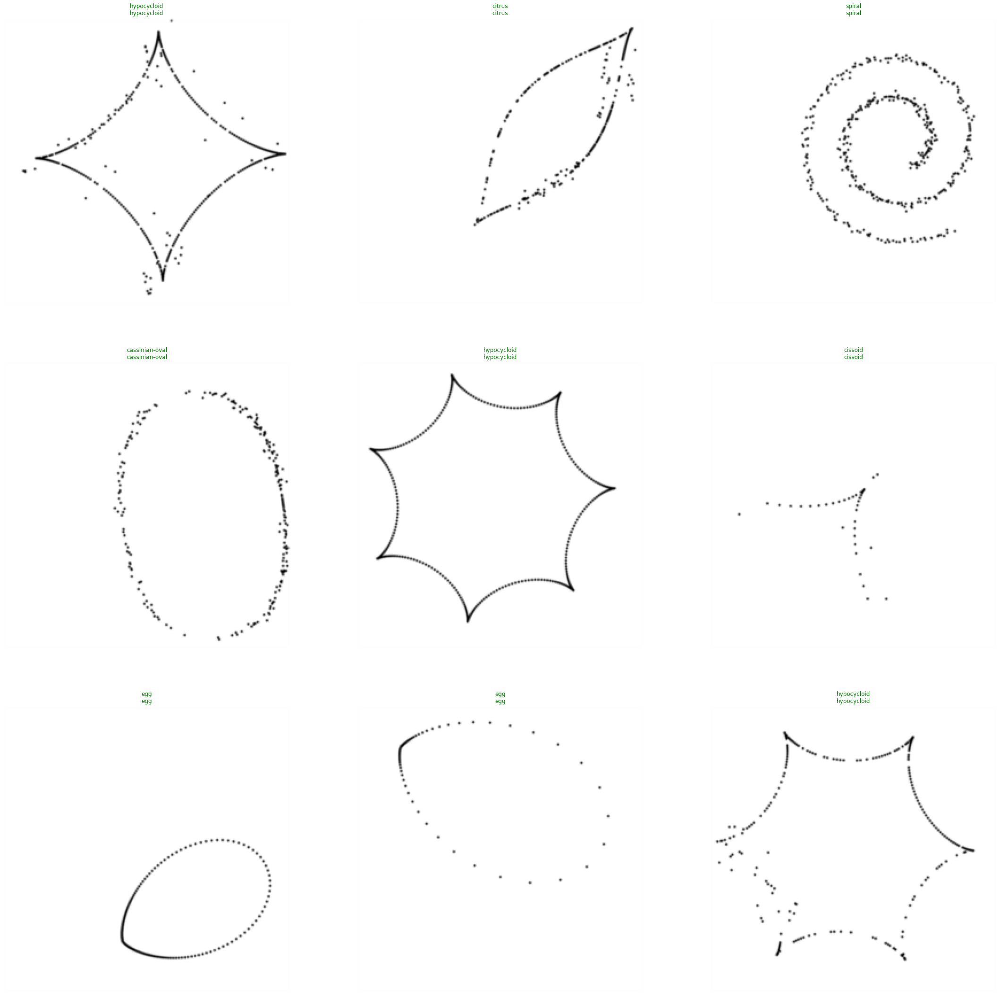

In [105]:
show_results(figsize=(38,38))

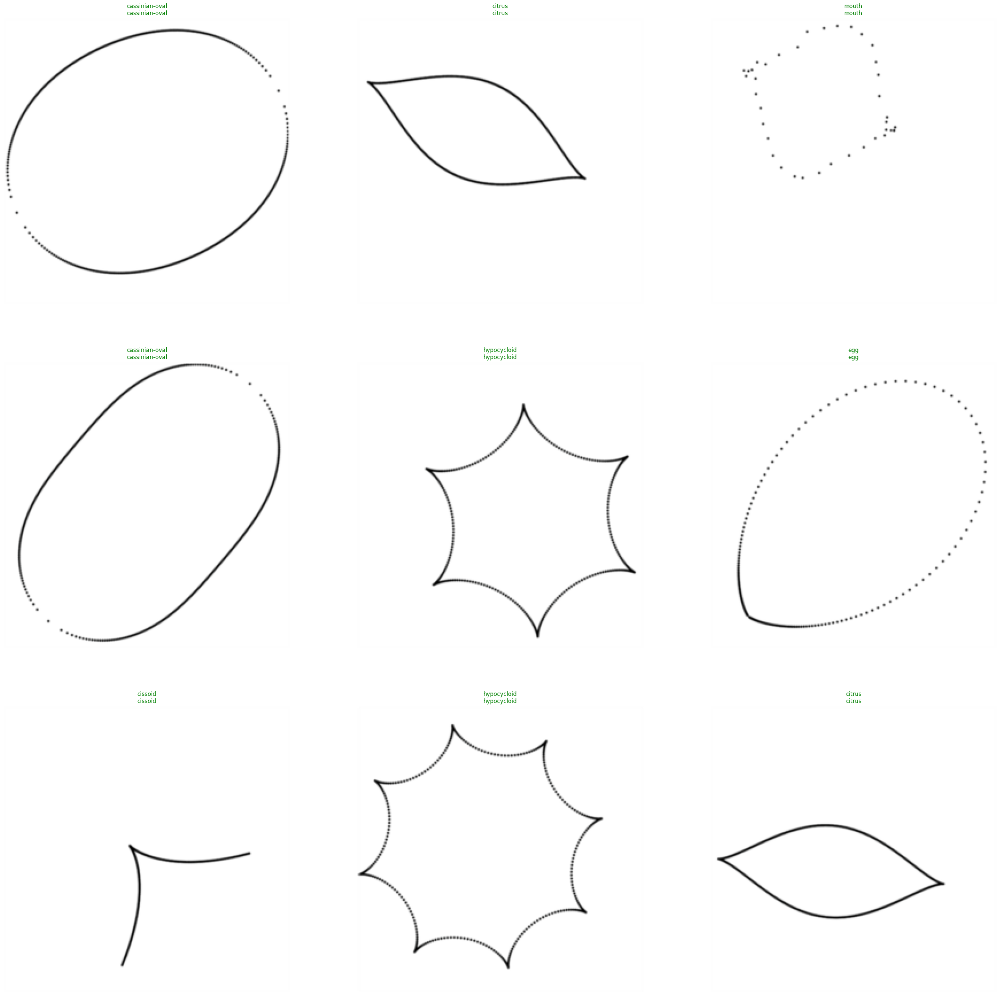

In [106]:
show_results(figsize=(38,38))

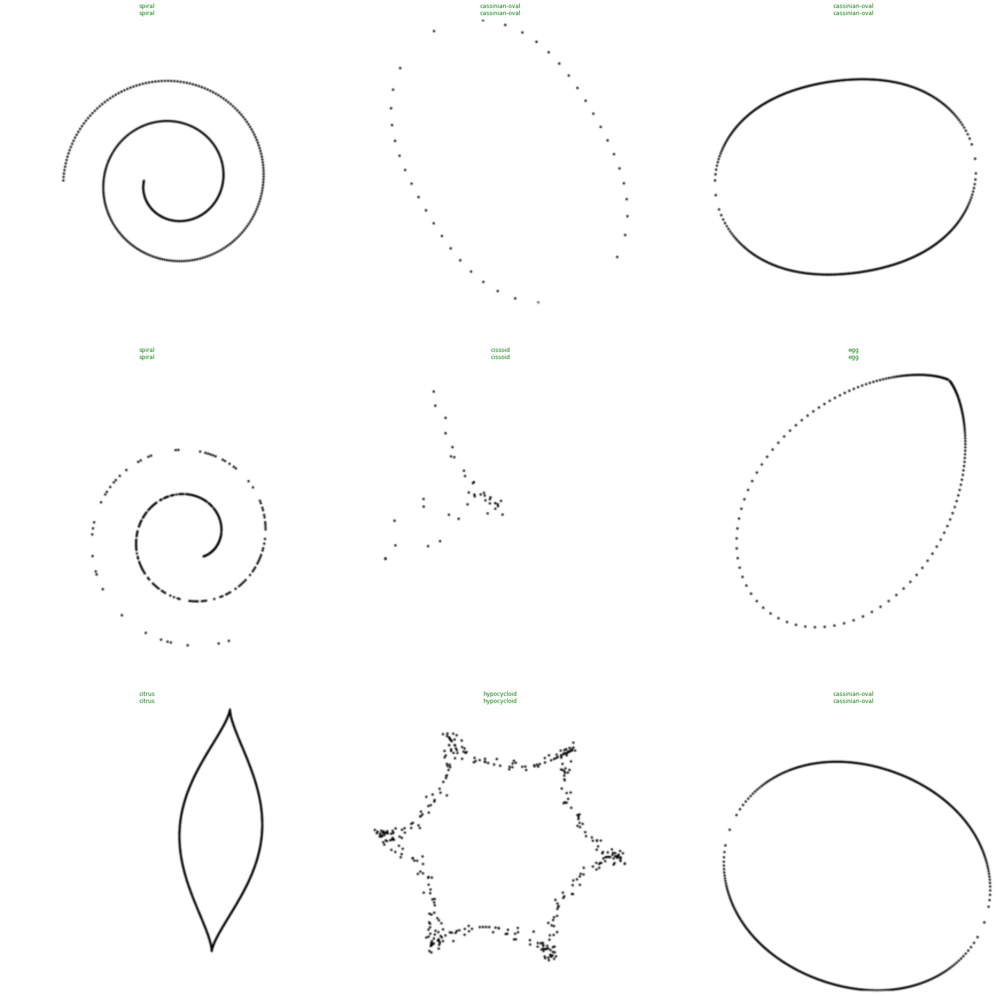

In [107]:
show_results(figsize=(38,38))

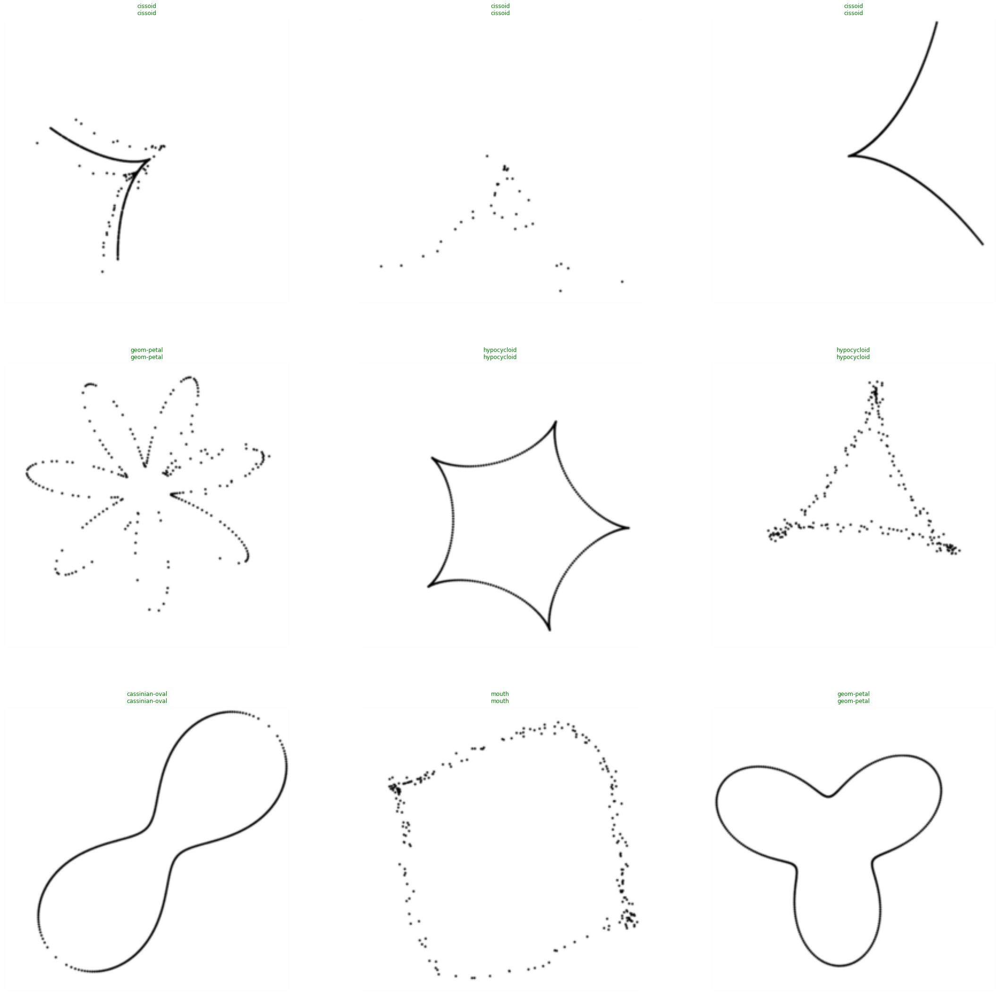

In [108]:
show_results(figsize=(38,38))

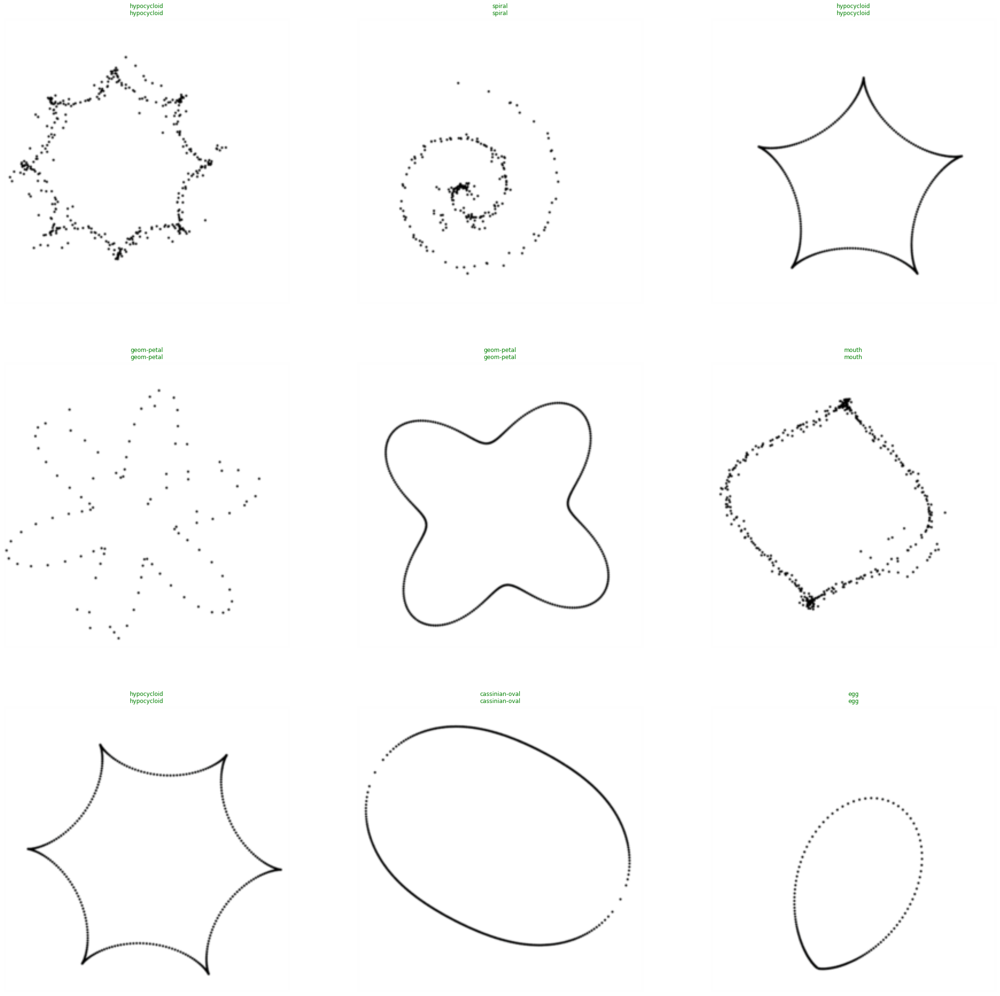

In [109]:
show_results(figsize=(38,38))

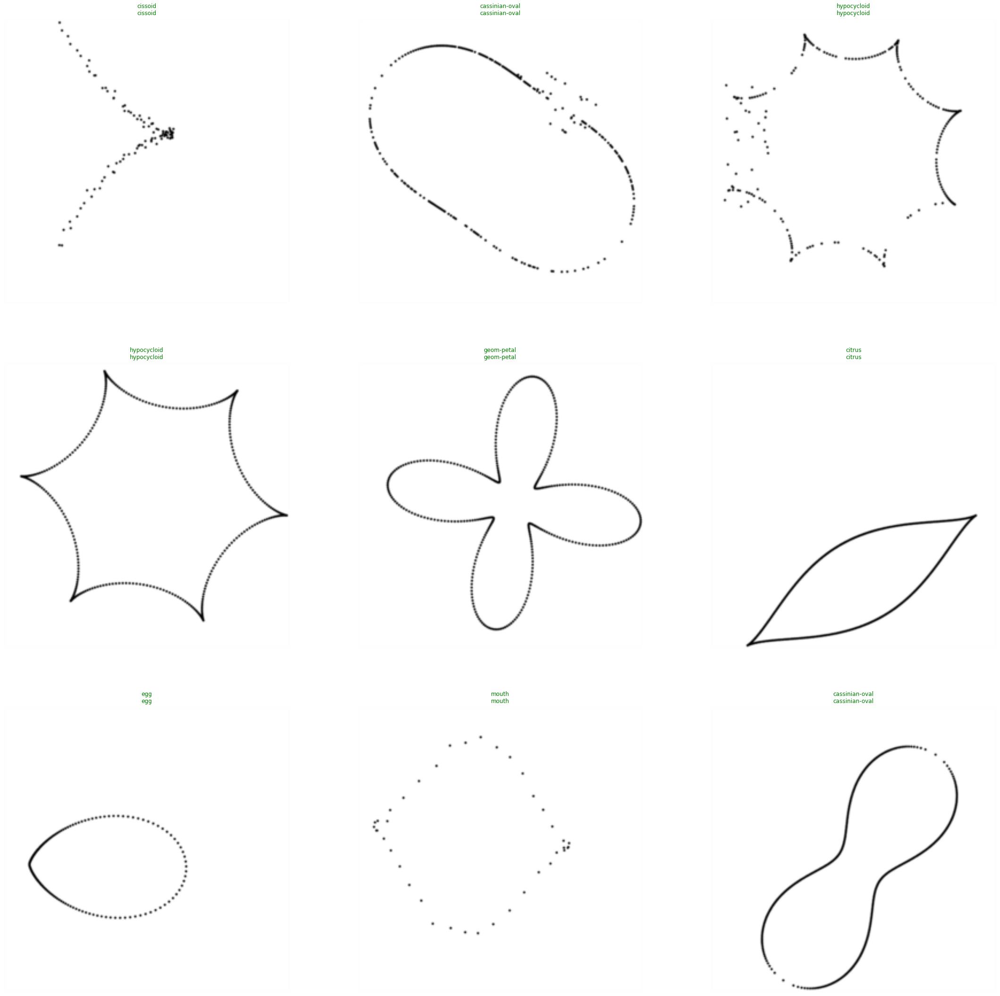

In [110]:
show_results(figsize=(38,38))

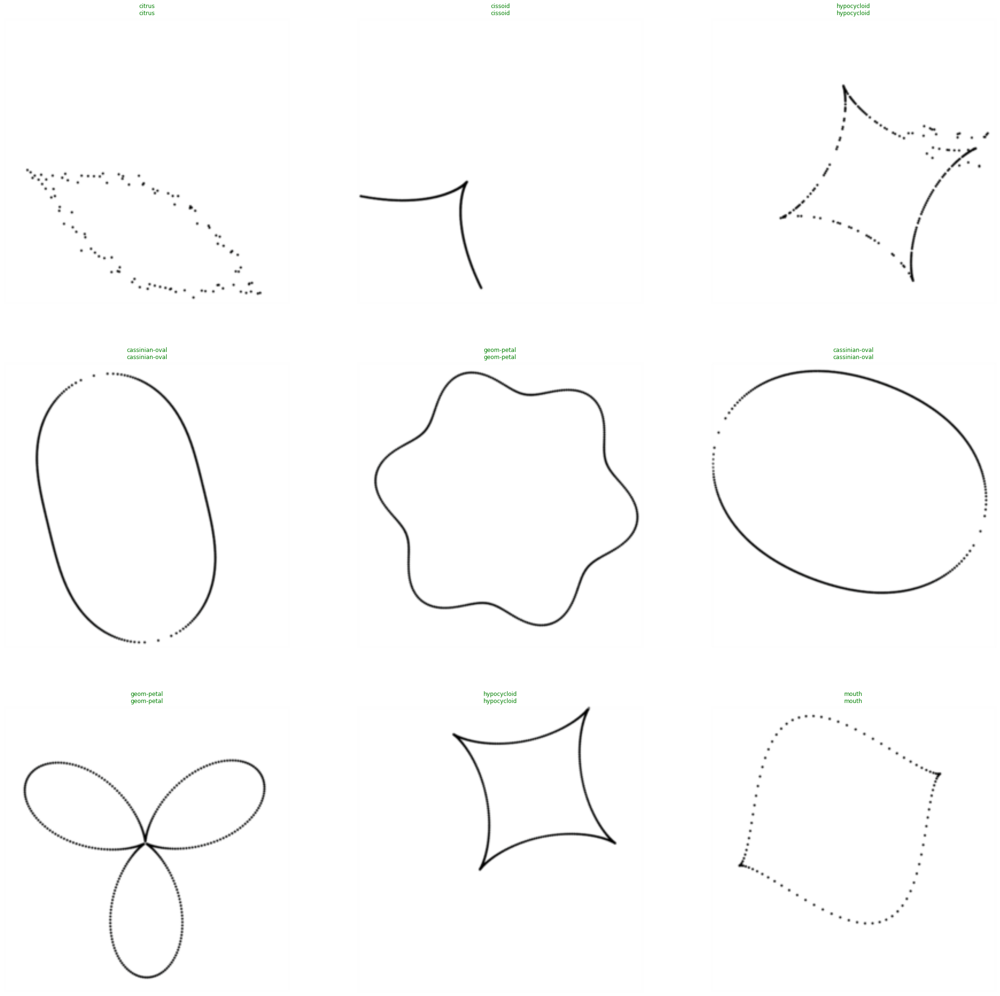

In [111]:
show_results(figsize=(38,38))

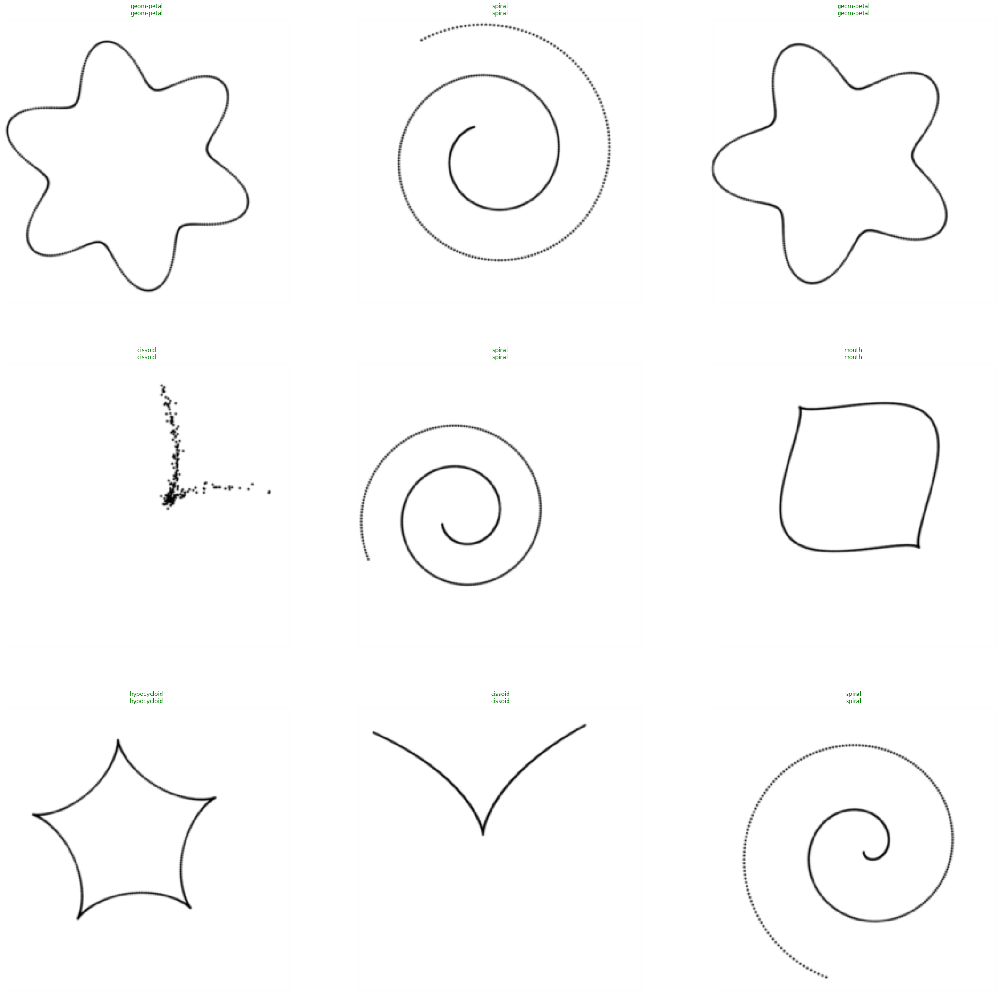

In [112]:
show_results(figsize=(38,38))

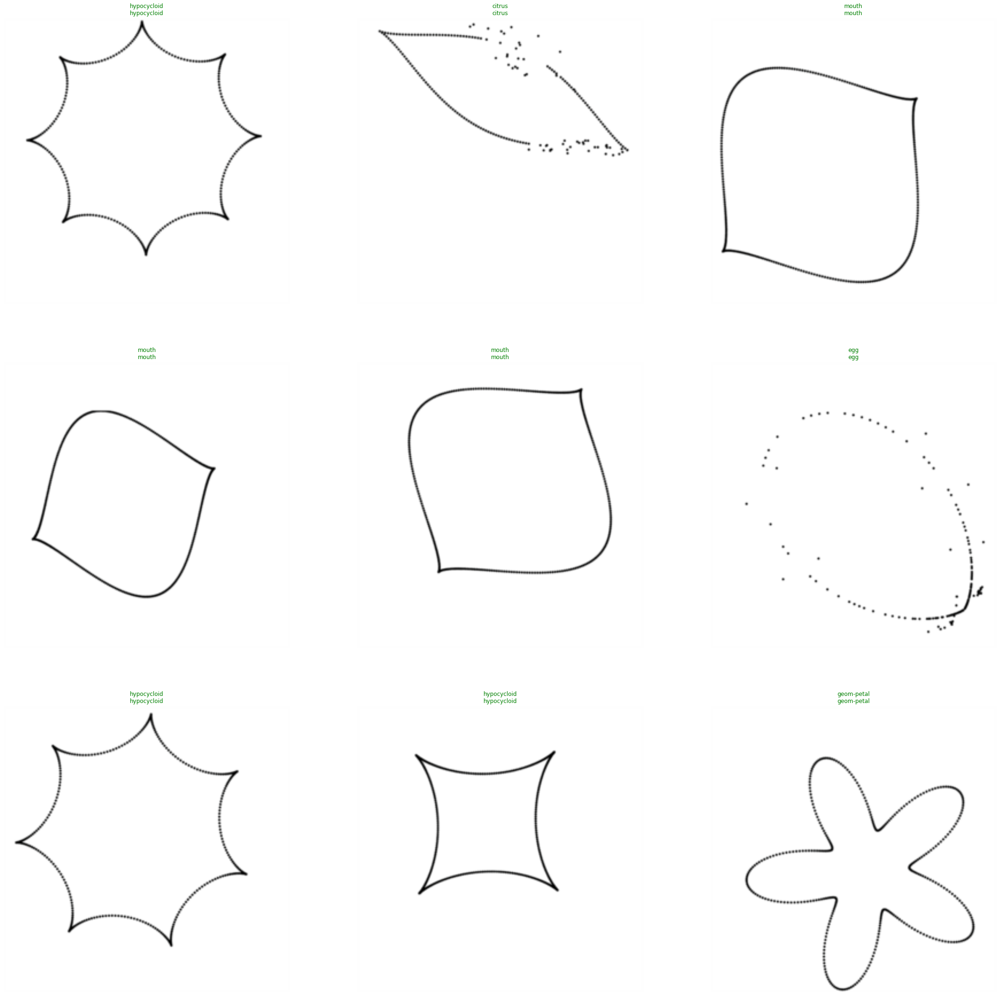

In [113]:
show_results(figsize=(38,38))

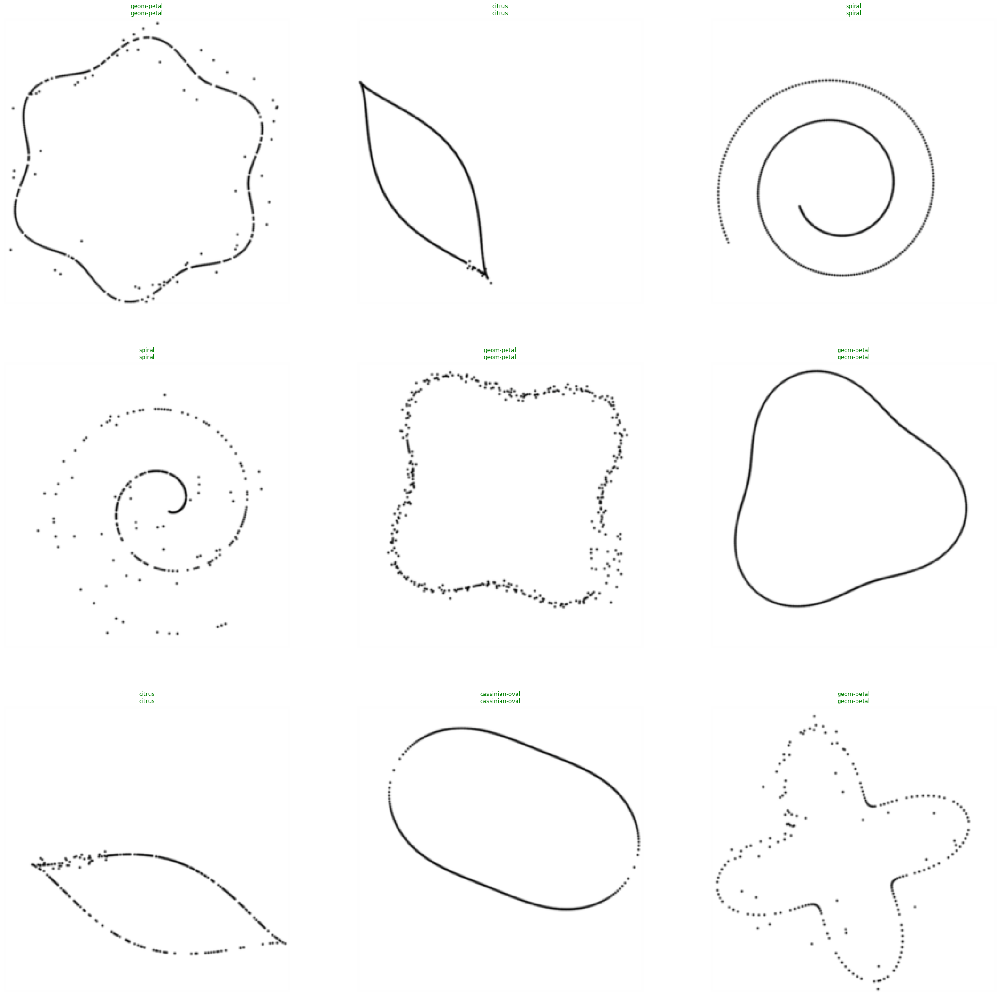

In [114]:
show_results(figsize=(38,38))

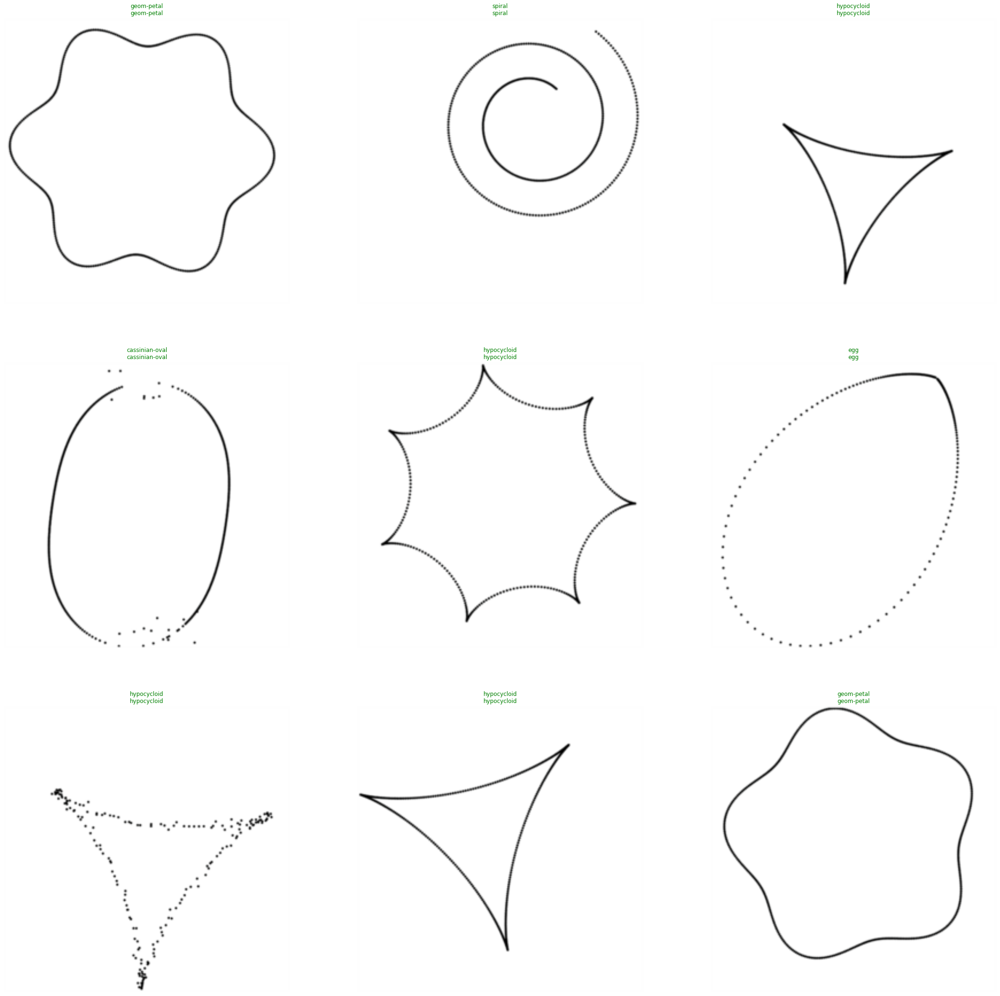

In [115]:
show_results(figsize=(38,38))

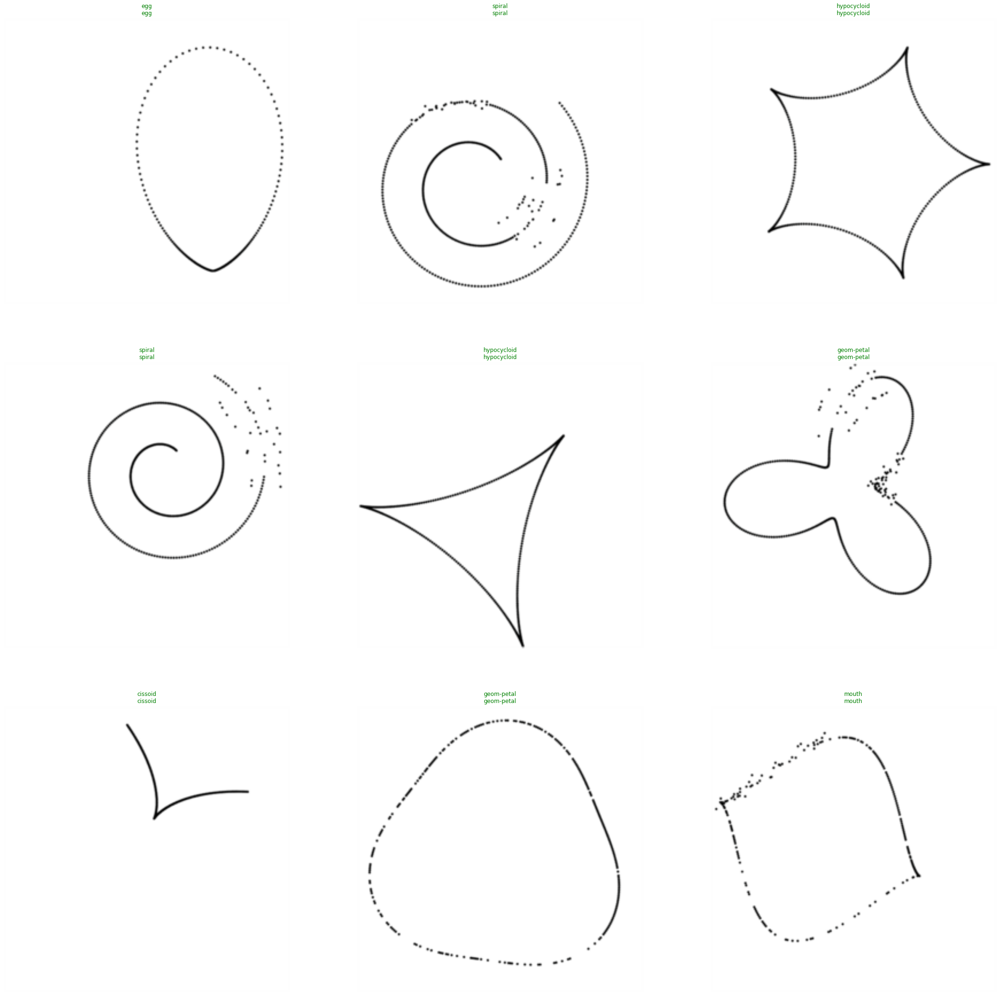

In [116]:
show_results(figsize=(38,38))